<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/code/attention/ImageCaptionGroup3_Attention_Resnet50_Flickr30.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#This notebook is used to generate the model for Attention
#attention + Flickr30 + Resnet50 + 50 Epochs

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
os.chdir('/content/drive/MyDrive/Project_Data/Flickr30k')

In [3]:
!pwd

/content/drive/MyDrive/Project_Data/Flickr30k


In [4]:
!ls

Flickr30_comments
Flickr30_images
Flickr30k_images.zip
Flickr30_npy
image_caption_flickr30_transformer20_resnet50_nomha.h5
image_caption_flickr30_transformer20_resnet50_nomha.pkl
image_caption_flickr30_transformer25_resnet50_nomha.h5
image_caption_flickr30_transformer25_resnet50_nomha.pkl
image_caption_flickr30_transformer30_resnet50_nomha.h5
image_caption_flickr30_transformer30_resnet50_nomha.pkl
image_caption_tokenizer.pkl


In [ ]:
!rm -rf /content/Flickr30_numpy

In [42]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1*.npy "/content/Flickr30_numpy"
print("completed 1")

completed 1


In [43]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2*.npy "/content/Flickr30_numpy"
print("completed 2")

completed 2


In [44]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3*.npy "/content/Flickr30_numpy"
print("completed 3")

completed 3


In [45]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4*.npy "/content/Flickr30_numpy"
print("completed 4")

completed 4


In [46]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5*.npy "/content/Flickr30_numpy"
print("completed 5")

completed 5


In [47]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6*.npy "/content/Flickr30_numpy"
print("completed 6")

completed 6


In [48]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7*.npy "/content/Flickr30_numpy"
print("completed 7")

completed 7


In [49]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/8*.npy "/content/Flickr30_numpy"
print("completed 8")

completed 8


In [50]:
!cp -r /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/9*.npy "/content/Flickr30_numpy"
print("completed 9")

completed 9


In [51]:
npys = os.listdir("/content/Flickr30_numpy")
print("npys count:", len(npys))

npys count: 31783


In [52]:
import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob
from pickle import dump, load
from time import time
from keras.preprocessing import sequence
from keras.models import Sequential
from keras import optimizers
from keras import Input, layers
from keras.applications.inception_v3 import preprocess_input
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector, Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.utils import plot_model
from nltk.translate.bleu_score import sentence_bleu
import tensorflow as tf

In [53]:
print ("tensor flow version", tf.__version__)

tensor flow version 2.8.2


In [54]:
import string
import numpy as np
import pandas as pd
from numpy import array
from pickle import load

from PIL import Image
import pickle
from collections import Counter
import matplotlib.pyplot as plt

import sys, time, os, warnings
warnings.filterwarnings("ignore")
import re

import keras
import tensorflow as tf
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
# from keras.utils import to_categorical
# from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [55]:
import fnmatch
image_path = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images"
dir_Flickr_text = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_comments/captions.txt"
#jpgs = os.listdir(image_path)
#jpgs = fnmatch.filter(os.listdir(image_path),'*.jpg')
#npys = fnmatch.filter(os.listdir(image_path),'*.npy')
#print("Total Images in Dataset = {}".format(len(jpgs)))
#print("Total npy in Dataset = {}".format(len(npys)))

In [56]:
dir_Flickr_text

'/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_comments/captions.txt'

In [57]:
# from keras.optimizers import Adam, RMSprop
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam, RMSprop

In [58]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

filename = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_comments/captions.txt"
# load descriptions
doc = load_doc(filename)
print(doc[:300])

1000092795.jpg|0|Two young guys with shaggy hair look at their hands while hanging out in the yard .
1000092795.jpg|1|Two young , White males are outside near many bushes .
1000092795.jpg|2|Two men in green shirts are standing in a yard .
1000092795.jpg|3|A man in a blue shirt standing in a garden .


In [59]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
    col = line.split('|')
    if len(col) == 1:
        continue
    #w = col[0].split("#")
    datatxt.append(col)

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']


uni_filenames = np.unique(data.filename.values)
data.head()

,index,filename,caption
0,0,1000092795.jpg,Two young guys with shaggy hair look at their ...
1,1,1000092795.jpg,"Two young , White males are outside near many ..."
2,2,1000092795.jpg,Two men in green shirts are standing in a yard .
3,3,1000092795.jpg,A man in a blue shirt standing in a garden .
4,4,1000092795.jpg,Two friends enjoy time spent together .


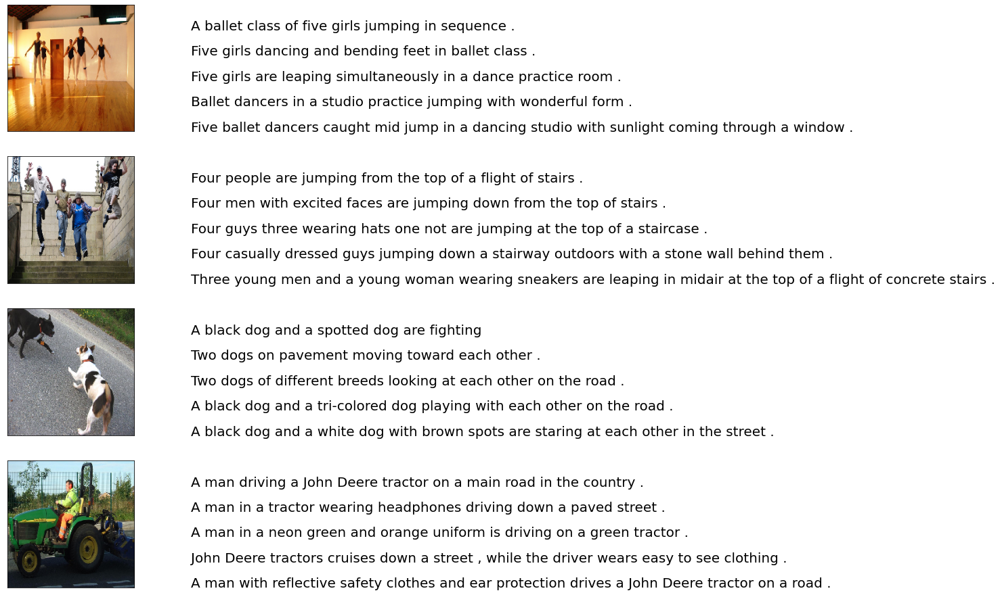

In [60]:
from keras.preprocessing.image import load_img, img_to_array
npic = 5
npix = 224
target_size = (npix,npix,3)  #224,224,3
count = 1

fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:14]:
   filename = image_path + '/' + jpgfnm
   captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
   image_load = load_img(filename, target_size=target_size)
   ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
   ax.imshow(image_load)
   count += 1

   ax = fig.add_subplot(npic,2,count)
   plt.axis('off')
   ax.plot()
   ax.set_xlim(0,1)
   ax.set_ylim(0,len(captions))
   for i, caption in enumerate(captions):
       ax.text(0,i,caption,fontsize=20)
   count += 1
plt.show()

In [61]:
vocabulary = []
for txt in data.caption.values:
   vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 23538


In [62]:
def remove_punctuation(text_original):
   text_no_punctuation = text_original.translate(string.punctuation)
   return(text_no_punctuation)

def remove_single_character(text):
   text_len_more_than1 = ""
   for word in text.split():
       if len(word) > 1:
           text_len_more_than1 += " " + word
   return(text_len_more_than1)

def remove_numeric(text):
   text_no_numeric = ""
   for word in text.split():
       isalpha = word.isalpha()
       if isalpha:
           text_no_numeric += " " + word
   return(text_no_numeric)

def text_clean(text_original):
   text = remove_punctuation(text_original)
   text = remove_single_character(text)
   text = remove_numeric(text)
   return(text)

for i, caption in enumerate(data.caption.values):
   newcaption = text_clean(caption)
   data["caption"].iloc[i] = newcaption

In [63]:
clean_vocabulary = []
for txt in data.caption.values:
   clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 20924


In [64]:
#PATH = "/content/Flicker8k_Dataset/"
PATH = "/content/Flickr30_numpy/"
#PATH = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/"
all_captions = []
for caption  in data["caption"].astype(str):
   caption = '<start> ' + caption+ ' <end>'
   all_captions.append(caption)

all_captions[:10]

['<start>  Two young guys with shaggy hair look at their hands while hanging out in the yard <end>',
 '<start>  Two young White males are outside near many bushes <end>',
 '<start>  Two men in green shirts are standing in yard <end>',
 '<start>  man in blue shirt standing in garden <end>',
 '<start>  Two friends enjoy time spent together <end>',
 '<start>  Several men in hard hats are operating giant pulley system <end>',
 '<start>  Workers look down from up above on piece of equipment <end>',
 '<start>  Two men working on machine wearing hard hats <end>',
 '<start>  Four men on top of tall structure <end>',
 '<start>  Three men on large rig <end>']

In [65]:
all_img_name_vector = []
for annot in data["filename"]:
   full_image_path = PATH + annot
   all_img_name_vector.append(full_image_path)

all_img_name_vector[:10]

['/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/1000092795.jpg',
 '/content/Flickr30_numpy/10002456.jpg',
 '/content/Flickr30_numpy/10002456.jpg',
 '/content/Flickr30_numpy/10002456.jpg',
 '/content/Flickr30_numpy/10002456.jpg',
 '/content/Flickr30_numpy/10002456.jpg']

In [66]:
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")
print(f"len(all_captions) : {len(all_captions)}")

len(all_img_name_vector) : 158915
len(all_captions) : 158915


In [67]:
#Clarify
def data_limiter(num,total_captions,all_img_name_vector):
 train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
 train_captions = train_captions[:num]
 img_name_vector = img_name_vector[:num]
 return train_captions,img_name_vector

train_captions,img_name_vector = data_limiter(158000,all_captions,all_img_name_vector)

In [68]:
img_name_vector[:10]

['/content/Flickr30_numpy/6321643151.jpg',
 '/content/Flickr30_numpy/3548191125.jpg',
 '/content/Flickr30_numpy/1680126311.jpg',
 '/content/Flickr30_numpy/3683185795.jpg',
 '/content/Flickr30_numpy/821599220.jpg',
 '/content/Flickr30_numpy/4443858093.jpg',
 '/content/Flickr30_numpy/2597452118.jpg',
 '/content/Flickr30_numpy/2339946012.jpg',
 '/content/Flickr30_numpy/470887791.jpg',
 '/content/Flickr30_numpy/3181328245.jpg']

In [69]:
def load_image(image_path):    
   img = tf.io.read_file(image_path)
   img = tf.image.decode_jpeg(img, channels=3)
   img = tf.image.resize(img, (224, 224))
   print('Shape before preprocess:', img.shape)
   #img = preprocess_input(img)
   print('Shape after preprocess:' , img.shape)

   return img, image_path #224,224,3

#image_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet')

image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")

new_input = image_model.input
hidden_layer = image_model.layers[-2].output
image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

image_features_extract_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                            

In [70]:
encode_train = sorted(set(img_name_vector))
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(64)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


In [71]:
len(encode_train)

31783

In [72]:
type(image_dataset)

tensorflow.python.data.ops.dataset_ops.BatchDataset

In [ ]:
for x,y in image_dataset:
    print(x.shape,y.shape)
    break

(64, 224, 224, 3) (64,)


In [ ]:
encode_train[0]

In [ ]:
type(encode_train),type(img_name_vector),type(image_dataset)

(list, list, tensorflow.python.data.ops.dataset_ops.BatchDataset)

In [ ]:
# Get unique images
#Run Selectively if the image converted to Numpy file using pretrained CNN file is built already
%%time
for img, path in tqdm(image_dataset):
 batch_features = image_features_extract_model(img)
 print(batch_features.shape) #(64, 7, 7, 512)
 batch_features = tf.reshape(batch_features,
                             (batch_features.shape[0], -1, batch_features.shape[3]))
 #print(batch_features.shape)  #(64, 49, 512)
 

 for bf, p in zip(batch_features, path):
   path_of_feature = p.numpy().decode("utf-8")
   #print(path_of_feature)
   np.save(path_of_feature, bf.numpy())
 #break

  1%|          | 1/127 [00:09<18:56,  9.02s/it]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


  2%|▏         | 3/127 [00:09<04:38,  2.25s/it]

(64, 7, 7, 2048)


  3%|▎         | 4/127 [00:09<03:00,  1.47s/it]

(64, 7, 7, 2048)


  4%|▍         | 5/127 [00:10<02:07,  1.05s/it]

(64, 7, 7, 2048)


  5%|▍         | 6/127 [00:10<01:35,  1.27it/s]

(64, 7, 7, 2048)


  6%|▌         | 7/127 [00:10<01:13,  1.64it/s]

(64, 7, 7, 2048)


  6%|▋         | 8/127 [00:10<00:58,  2.03it/s]

(64, 7, 7, 2048)


  7%|▋         | 9/127 [00:11<00:48,  2.41it/s]

(64, 7, 7, 2048)


  8%|▊         | 10/127 [00:11<00:44,  2.61it/s]

(64, 7, 7, 2048)


  9%|▊         | 11/127 [00:11<00:40,  2.90it/s]

(64, 7, 7, 2048)


  9%|▉         | 12/127 [00:12<00:36,  3.15it/s]

(64, 7, 7, 2048)


 10%|█         | 13/127 [00:12<00:34,  3.32it/s]

(64, 7, 7, 2048)


 11%|█         | 14/127 [00:12<00:32,  3.49it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 13%|█▎        | 16/127 [00:13<00:31,  3.56it/s]

(64, 7, 7, 2048)


 13%|█▎        | 17/127 [00:13<00:30,  3.65it/s]

(64, 7, 7, 2048)


 14%|█▍        | 18/127 [00:13<00:29,  3.71it/s]

(64, 7, 7, 2048)


 15%|█▍        | 19/127 [00:13<00:28,  3.79it/s]

(64, 7, 7, 2048)


 16%|█▌        | 20/127 [00:14<00:27,  3.91it/s]

(64, 7, 7, 2048)


 17%|█▋        | 21/127 [00:14<00:28,  3.68it/s]

(64, 7, 7, 2048)


 17%|█▋        | 22/127 [00:14<00:28,  3.70it/s]

(64, 7, 7, 2048)


 18%|█▊        | 23/127 [00:14<00:27,  3.78it/s]

(64, 7, 7, 2048)


 19%|█▉        | 24/127 [00:15<00:26,  3.91it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 20%|██        | 26/127 [00:15<00:27,  3.70it/s]

(64, 7, 7, 2048)


 21%|██▏       | 27/127 [00:15<00:25,  3.85it/s]

(64, 7, 7, 2048)


 22%|██▏       | 28/127 [00:16<00:24,  3.98it/s]

(64, 7, 7, 2048)


 23%|██▎       | 29/127 [00:16<00:26,  3.73it/s]

(64, 7, 7, 2048)


 24%|██▎       | 30/127 [00:16<00:26,  3.70it/s]

(64, 7, 7, 2048)


 24%|██▍       | 31/127 [00:17<00:25,  3.80it/s]

(64, 7, 7, 2048)


 25%|██▌       | 32/127 [00:17<00:24,  3.92it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 27%|██▋       | 34/127 [00:17<00:24,  3.83it/s]

(64, 7, 7, 2048)


 28%|██▊       | 35/127 [00:18<00:24,  3.72it/s]

(64, 7, 7, 2048)


 28%|██▊       | 36/127 [00:18<00:23,  3.81it/s]

(64, 7, 7, 2048)


 29%|██▉       | 37/127 [00:18<00:23,  3.90it/s]

(64, 7, 7, 2048)


 30%|██▉       | 38/127 [00:18<00:23,  3.71it/s]

(64, 7, 7, 2048)


 31%|███       | 39/127 [00:19<00:23,  3.72it/s]

(64, 7, 7, 2048)


 31%|███▏      | 40/127 [00:19<00:22,  3.79it/s]

(64, 7, 7, 2048)


 32%|███▏      | 41/127 [00:19<00:22,  3.80it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 34%|███▍      | 43/127 [00:20<00:21,  3.90it/s]

(64, 7, 7, 2048)


 35%|███▍      | 44/127 [00:20<00:22,  3.70it/s]

(64, 7, 7, 2048)


 35%|███▌      | 45/127 [00:20<00:22,  3.60it/s]

(64, 7, 7, 2048)


 36%|███▌      | 46/127 [00:21<00:21,  3.69it/s]

(64, 7, 7, 2048)


 37%|███▋      | 47/127 [00:21<00:21,  3.79it/s]

(64, 7, 7, 2048)


 38%|███▊      | 48/127 [00:21<00:20,  3.93it/s]

(64, 7, 7, 2048)


 39%|███▊      | 49/127 [00:21<00:20,  3.75it/s]

(64, 7, 7, 2048)


 39%|███▉      | 50/127 [00:22<00:20,  3.73it/s]

(64, 7, 7, 2048)


 40%|████      | 51/127 [00:22<00:19,  3.82it/s]

(64, 7, 7, 2048)


 41%|████      | 52/127 [00:22<00:19,  3.91it/s]

(64, 7, 7, 2048)


 42%|████▏     | 53/127 [00:22<00:18,  3.95it/s]

(64, 7, 7, 2048)


 43%|████▎     | 54/127 [00:23<00:19,  3.69it/s]

(64, 7, 7, 2048)


 43%|████▎     | 55/127 [00:23<00:19,  3.76it/s]

(64, 7, 7, 2048)


 44%|████▍     | 56/127 [00:23<00:18,  3.82it/s]

(64, 7, 7, 2048)


 45%|████▍     | 57/127 [00:23<00:19,  3.67it/s]

(64, 7, 7, 2048)


 46%|████▌     | 58/127 [00:24<00:18,  3.68it/s]

(64, 7, 7, 2048)


 46%|████▋     | 59/127 [00:24<00:18,  3.71it/s]

(64, 7, 7, 2048)


 47%|████▋     | 60/127 [00:24<00:17,  3.74it/s]

(64, 7, 7, 2048)


 48%|████▊     | 61/127 [00:24<00:17,  3.81it/s]

(64, 7, 7, 2048)


 49%|████▉     | 62/127 [00:25<00:16,  3.90it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 50%|█████     | 64/127 [00:25<00:16,  3.73it/s]

(64, 7, 7, 2048)


 51%|█████     | 65/127 [00:26<00:16,  3.77it/s]

(64, 7, 7, 2048)


 52%|█████▏    | 66/127 [00:26<00:15,  3.83it/s]

(64, 7, 7, 2048)


 53%|█████▎    | 67/127 [00:26<00:15,  3.83it/s]

(64, 7, 7, 2048)


 54%|█████▎    | 68/127 [00:26<00:16,  3.68it/s]

(64, 7, 7, 2048)


 54%|█████▍    | 69/127 [00:27<00:15,  3.80it/s]

(64, 7, 7, 2048)


 55%|█████▌    | 70/127 [00:27<00:14,  3.89it/s]

(64, 7, 7, 2048)


 56%|█████▌    | 71/127 [00:27<00:14,  3.99it/s]

(64, 7, 7, 2048)


 57%|█████▋    | 72/127 [00:27<00:13,  4.09it/s]

(64, 7, 7, 2048)


 57%|█████▋    | 73/127 [00:28<00:14,  3.70it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 59%|█████▉    | 75/127 [00:28<00:11,  4.40it/s]

(64, 7, 7, 2048)


 60%|█████▉    | 76/127 [00:28<00:14,  3.41it/s]

(64, 7, 7, 2048)


 61%|██████    | 77/127 [00:29<00:14,  3.46it/s]

(64, 7, 7, 2048)


 61%|██████▏   | 78/127 [00:29<00:15,  3.26it/s]

(64, 7, 7, 2048)


 62%|██████▏   | 79/127 [00:29<00:14,  3.43it/s]

(64, 7, 7, 2048)


 63%|██████▎   | 80/127 [00:30<00:13,  3.60it/s]

(64, 7, 7, 2048)


 64%|██████▍   | 81/127 [00:30<00:12,  3.70it/s]

(64, 7, 7, 2048)


 65%|██████▍   | 82/127 [00:30<00:11,  3.76it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 66%|██████▌   | 84/127 [00:31<00:10,  4.00it/s]

(64, 7, 7, 2048)


 67%|██████▋   | 85/127 [00:31<00:10,  3.87it/s]

(64, 7, 7, 2048)


 68%|██████▊   | 86/127 [00:31<00:10,  3.82it/s]

(64, 7, 7, 2048)


 69%|██████▊   | 87/127 [00:31<00:10,  3.83it/s]

(64, 7, 7, 2048)


 69%|██████▉   | 88/127 [00:32<00:09,  3.97it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 71%|███████   | 90/127 [00:32<00:09,  4.06it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 72%|███████▏  | 92/127 [00:33<00:09,  3.52it/s]

(64, 7, 7, 2048)


 73%|███████▎  | 93/127 [00:33<00:09,  3.72it/s]

(64, 7, 7, 2048)


 74%|███████▍  | 94/127 [00:33<00:08,  3.81it/s]

(64, 7, 7, 2048)


 75%|███████▍  | 95/127 [00:34<00:08,  3.62it/s]

(64, 7, 7, 2048)


 76%|███████▌  | 96/127 [00:34<00:08,  3.76it/s]

(64, 7, 7, 2048)


 76%|███████▋  | 97/127 [00:34<00:07,  3.90it/s]

(64, 7, 7, 2048)


 77%|███████▋  | 98/127 [00:34<00:07,  3.87it/s]

(64, 7, 7, 2048)


 78%|███████▊  | 99/127 [00:34<00:06,  4.09it/s]

(64, 7, 7, 2048)


 79%|███████▊  | 100/127 [00:35<00:06,  3.87it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 80%|████████  | 102/127 [00:35<00:06,  3.79it/s]

(64, 7, 7, 2048)


 81%|████████  | 103/127 [00:36<00:06,  3.98it/s]

(64, 7, 7, 2048)


 82%|████████▏ | 104/127 [00:36<00:05,  4.11it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 83%|████████▎ | 106/127 [00:36<00:04,  4.21it/s]

(64, 7, 7, 2048)


 84%|████████▍ | 107/127 [00:37<00:05,  3.72it/s]

(64, 7, 7, 2048)


 85%|████████▌ | 108/127 [00:37<00:07,  2.64it/s]

(64, 7, 7, 2048)


 86%|████████▌ | 109/127 [00:37<00:06,  2.87it/s]

(64, 7, 7, 2048)


 87%|████████▋ | 110/127 [00:38<00:05,  3.10it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 88%|████████▊ | 112/127 [00:38<00:04,  3.34it/s]

(64, 7, 7, 2048)


 89%|████████▉ | 113/127 [00:39<00:03,  3.69it/s]

(64, 7, 7, 2048)


 90%|████████▉ | 114/127 [00:39<00:03,  3.83it/s]

(64, 7, 7, 2048)


 91%|█████████ | 115/127 [00:39<00:03,  3.69it/s]

(64, 7, 7, 2048)


 91%|█████████▏| 116/127 [00:39<00:02,  3.71it/s]

(64, 7, 7, 2048)


 92%|█████████▏| 117/127 [00:40<00:02,  3.66it/s]

(64, 7, 7, 2048)


 93%|█████████▎| 118/127 [00:40<00:02,  3.63it/s]

(64, 7, 7, 2048)


 94%|█████████▎| 119/127 [00:40<00:02,  3.58it/s]

(64, 7, 7, 2048)


 94%|█████████▍| 120/127 [00:40<00:01,  3.64it/s]

(64, 7, 7, 2048)


 95%|█████████▌| 121/127 [00:41<00:01,  3.53it/s]

(64, 7, 7, 2048)


 96%|█████████▌| 122/127 [00:41<00:01,  3.75it/s]

(64, 7, 7, 2048)


 97%|█████████▋| 123/127 [00:41<00:01,  3.76it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 98%|█████████▊| 125/127 [00:42<00:00,  3.36it/s]

(64, 7, 7, 2048)


 99%|█████████▉| 126/127 [00:42<00:00,  3.64it/s]

(64, 7, 7, 2048)


100%|██████████| 127/127 [00:42<00:00,  3.99it/s]

(27, 7, 7, 2048)


100%|██████████| 127/127 [01:21<00:00,  1.55it/s]

CPU times: user 49.9 s, sys: 6.36 s, total: 56.3 s
Wall time: 1min 21s


In [73]:
top_k = 5000
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                 oov_token="<unk>",
                                                 filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')

tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

train_seqs = tokenizer.texts_to_sequences(train_captions)
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
len(cap_vector[0])

74

In [74]:
def calc_max_length(tensor):
   return max(len(t) for t in tensor)
max_length = calc_max_length(train_seqs)

def calc_min_length(tensor):
   return min(len(t) for t in tensor)
min_length = calc_min_length(train_seqs)

print('Max Length of any caption : Min Length of any caption = '+ str(max_length) +" : "+str(min_length))

Max Length of any caption : Min Length of any caption = 74 : 3


In [75]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,cap_vector, test_size=0.2, random_state=0)

In [76]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 256
units = 512
vocab_size = len(tokenizer.word_index) + 1
num_steps = len(img_name_train) // BATCH_SIZE
features_shape = 512
attention_features_shape = 49

In [77]:
#Clarify
def map_func(img_name, cap):
 img_tensor = np.load(img_name.decode('utf-8')+'.npy')
#  print(img_name.decode('utf-8')+'.npy')
#  print(type(img_tensor))
 return img_tensor, cap
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
        map_func, [item1, item2], [tf.float32, tf.int32]),
         num_parallel_calls=tf.data.experimental.AUTOTUNE)

dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
#img_tensor = np.load('/content/Flicker8k_Dataset/3648988742_888a16f600.jpg.npy')
#print(type(img_tensor))

<class 'numpy.ndarray'>


In [ ]:
for x,y in dataset:
    print(x)
    break

In [78]:
class Resnet50_Encoder(tf.keras.Model):
   # This encoder passes the features through a Fully connected layer
   def __init__(self, embedding_dim):
       super(Resnet50_Encoder, self).__init__()
       # shape after fc == (batch_size, 49, embedding_dim)
       self.fc = tf.keras.layers.Dense(embedding_dim)
       self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

   def call(self, x):
       #x= self.dropout(x)
       x = self.fc(x)
       x = tf.nn.relu(x)
       return x   
#We define our RNN based on GPU/CPU capabilities-

def rnn_type(units):
   if tf.test.is_gpu_available():
       return tf.compat.v1.keras.layers.CuDNNLSTM(units,
                                       return_sequences=True,
                                       return_state=True,
                                       recurrent_initializer='glorot_uniform')
   else:
       return tf.keras.layers.GRU(units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_activation='sigmoid',
                                  recurrent_initializer='glorot_uniform')

In [79]:
encoder = Resnet50_Encoder(embedding_dim)

In [ ]:
#For later
#from torchsummary import summary
#summary(encoder, input_size=(1, 49, 3))

In [80]:
'''The encoder output(i.e. 'features'), hidden state(initialized to 0)(i.e. 'hidden') and
the decoder input (which is the start token)(i.e. 'x') is passed to the decoder.'''

class Rnn_Local_Decoder(tf.keras.Model):
 def __init__(self, embedding_dim, units, vocab_size):
   super(Rnn_Local_Decoder, self).__init__()
   self.units = units
   self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
   self.gru = tf.keras.layers.GRU(self.units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_initializer='glorot_uniform')
  
   self.fc1 = tf.keras.layers.Dense(self.units)

   self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)
   self.batchnormalization = tf.keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

   self.fc2 = tf.keras.layers.Dense(vocab_size)

   # Implementing Attention Mechanism
   self.Uattn = tf.keras.layers.Dense(units)
   self.Wattn = tf.keras.layers.Dense(units)
   self.Vattn = tf.keras.layers.Dense(1)

 def call(self, x, features, hidden):
   # features shape ==> (64,49,256) ==> Output from ENCODER
   # hidden shape == (batch_size, hidden_size) ==>(64,512)
   # hidden_with_time_axis shape == (batch_size, 1, hidden_size) ==> (64,1,512)

   hidden_with_time_axis = tf.expand_dims(hidden, 1)

   # score shape == (64, 49, 1)
   # Attention Function
   '''e(ij) = f(s(t-1),h(j))'''
   ''' e(ij) = Vattn(T)*tanh(Uattn * h(j) + Wattn * s(t))'''

   score = self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)))

   # self.Uattn(features) : (64,49,512)
   # self.Wattn(hidden_with_time_axis) : (64,1,512)
   # tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)) : (64,49,512)
   # self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis))) : (64,49,1) ==> score

   # you get 1 at the last axis because you are applying score to self.Vattn
   # Then find Probability using Softmax
   '''attention_weights(alpha(ij)) = softmax(e(ij))'''

   attention_weights = tf.nn.softmax(score, axis=1)

   # attention_weights shape == (64, 49, 1)
   # Give weights to the different pixels in the image
   ''' C(t) = Summation(j=1 to T) (attention_weights * VGG-16 features) '''

   context_vector = attention_weights * features
   context_vector = tf.reduce_sum(context_vector, axis=1)

   # Context Vector(64,256) = AttentionWeights(64,49,1) * features(64,49,256)
   # context_vector shape after sum == (64, 256)
   # x shape after passing through embedding == (64, 1, 256)

   x = self.embedding(x)
   # x shape after concatenation == (64, 1,  512)

   x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)
   # passing the concatenated vector to the GRU

   output, state = self.gru(x)
   # shape == (batch_size, max_length, hidden_size)

   x = self.fc1(output)
   # x shape == (batch_size * max_length, hidden_size)

   x = tf.reshape(x, (-1, x.shape[2]))

   # Adding Dropout and BatchNorm Layers
   x= self.dropout(x)
   x= self.batchnormalization(x)

   # output shape == (64 * 512)
   x = self.fc2(x)

   # shape : (64 * 8329(vocab))
   return x, state, attention_weights

 def reset_state(self, batch_size):
   return tf.zeros((batch_size, self.units))


encoder = Resnet50_Encoder(embedding_dim)
decoder = Rnn_Local_Decoder(embedding_dim, units, vocab_size)

In [81]:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
   from_logits=True, reduction='none')

def loss_function(real, pred):
 mask = tf.math.logical_not(tf.math.equal(real, 0))
 loss_ = loss_object(real, pred)
 mask = tf.cast(mask, dtype=loss_.dtype)
 loss_ *= mask
 return tf.reduce_mean(loss_)

In [ ]:
[tokenizer.word_index['<start>']] * BATCH_SIZE

In [ ]:
 dec_input1 = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

In [ ]:
dec_input1

In [ ]:
dec_input1.shape

TensorShape([64, 1])

In [82]:
loss_plot = []

@tf.function
def train_step(img_tensor, target):
 loss = 0
 # initializing the hidden state for each batch
 # because the captions are not related from image to image

 hidden = decoder.reset_state(batch_size=target.shape[0])
 dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

 with tf.GradientTape() as tape:
     features = encoder(img_tensor)
     for i in range(1, target.shape[1]):
         # passing the features through the decoder
         predictions, hidden, _ = decoder(dec_input, features, hidden)
         loss += loss_function(target[:, i], predictions)

         # using teacher forcing
         dec_input = tf.expand_dims(target[:, i], 1)

 total_loss = (loss / int(target.shape[1]))
 trainable_variables = encoder.trainable_variables + decoder.trainable_variables
 gradients = tape.gradient(loss, trainable_variables)
 optimizer.apply_gradients(zip(gradients, trainable_variables))

 return loss, total_loss

In [83]:
start_epoch=0

In [118]:
EPOCHS = 5
for epoch in range(start_epoch, EPOCHS):
   start = time.time()
   total_loss = 0

   for (batch, (img_tensor, target)) in enumerate(dataset):
       batch_loss, t_loss = train_step(img_tensor, target)
       total_loss += t_loss

       if batch % 100 == 0:
           print ('Epoch {} Batch {} Loss {:.4f}'.format(
             epoch + 1, batch, batch_loss.numpy() / int(target.shape[1])))
   # storing the epoch end loss value to plot later
   loss_plot.append(total_loss / num_steps)

   print ('Epoch {} Loss {:.6f}'.format(epoch + 1,
                                        total_loss/num_steps))

   print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))


Epoch 1 Batch 0 Loss 0.3403
Epoch 1 Batch 100 Loss 0.3663
Epoch 1 Batch 200 Loss 0.3731
Epoch 1 Batch 300 Loss 0.3413
Epoch 1 Batch 400 Loss 0.3518
Epoch 1 Batch 500 Loss 0.3416
Epoch 1 Batch 600 Loss 0.3779
Epoch 1 Batch 700 Loss 0.3228
Epoch 1 Batch 800 Loss 0.3619
Epoch 1 Batch 900 Loss 0.3468
Epoch 1 Batch 1000 Loss 0.3181
Epoch 1 Batch 1100 Loss 0.3207
Epoch 1 Batch 1200 Loss 0.3282
Epoch 1 Batch 1300 Loss 0.3062
Epoch 1 Batch 1400 Loss 0.3288
Epoch 1 Batch 1500 Loss 0.3289
Epoch 1 Batch 1600 Loss 0.3392
Epoch 1 Batch 1700 Loss 0.3762
Epoch 1 Batch 1800 Loss 0.3175
Epoch 1 Batch 1900 Loss 0.2836
Epoch 1 Loss 0.330365
Time taken for 1 epoch 682.6084868907928 sec

Epoch 2 Batch 0 Loss 0.3372
Epoch 2 Batch 100 Loss 0.3769
Epoch 2 Batch 200 Loss 0.2819
Epoch 2 Batch 300 Loss 0.3166
Epoch 2 Batch 400 Loss 0.3238
Epoch 2 Batch 500 Loss 0.3270
Epoch 2 Batch 600 Loss 0.2915
Epoch 2 Batch 700 Loss 0.3289
Epoch 2 Batch 800 Loss 0.3604
Epoch 2 Batch 900 Loss 0.2847
Epoch 2 Batch 1000 Loss 0.

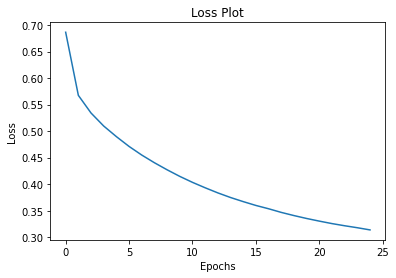

In [120]:
#Let’s plot the error graph:

plt.plot(loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

In [121]:
def evaluate(image):
   attention_plot = np.zeros((max_length, attention_features_shape))

   hidden = decoder.reset_state(batch_size=1)
   temp_input = tf.expand_dims(load_image(image)[0], 0)
   img_tensor_val = image_features_extract_model(temp_input)
   img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
   features = encoder(img_tensor_val)
   dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
   result = []

   for i in range(max_length):
       predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
       attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()
       predicted_id = tf.argmax(predictions[0]).numpy()
       result.append(tokenizer.index_word[predicted_id])

       if tokenizer.index_word[predicted_id] == '<end>':
           return result, attention_plot

       dec_input = tf.expand_dims([predicted_id], 0)
   attention_plot = attention_plot[:len(result), :]

   return result, attention_plot

In [85]:
def plot_attention(image, result, attention_plot):
   temp_image = np.array(Image.open(image))
   fig = plt.figure(figsize=(10, 10))
   len_result = len(result)
   for l in range(len_result):
       temp_att = np.resize(attention_plot[l], (8, 8))
       ax = fig.add_subplot(len_result//2, len_result//2, l+1)
       ax.set_title(result[l])
       img = ax.imshow(temp_image)
       ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

   plt.tight_layout()
   plt.show()

In [122]:
decoder.save_weights('image_caption_decoder_attention25_resnet50_Flickr30.h5')

In [123]:
encoder.save_weights('image_caption_encoder_attention25_resnet50_Flickr30.h5')

In [113]:
pkl_tokenizer_file="image_caption_tokenizer_attention_Flickr30.pkl"
with open(pkl_tokenizer_file, "wb") as encoded_pickle_tokenizer:
    dump(tokenizer, encoded_pickle_tokenizer)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
BELU score: 9.709385502639236e-230
Real Caption: Two white dogs are playing in the snow
Prediction Caption: two farmers working in rice field


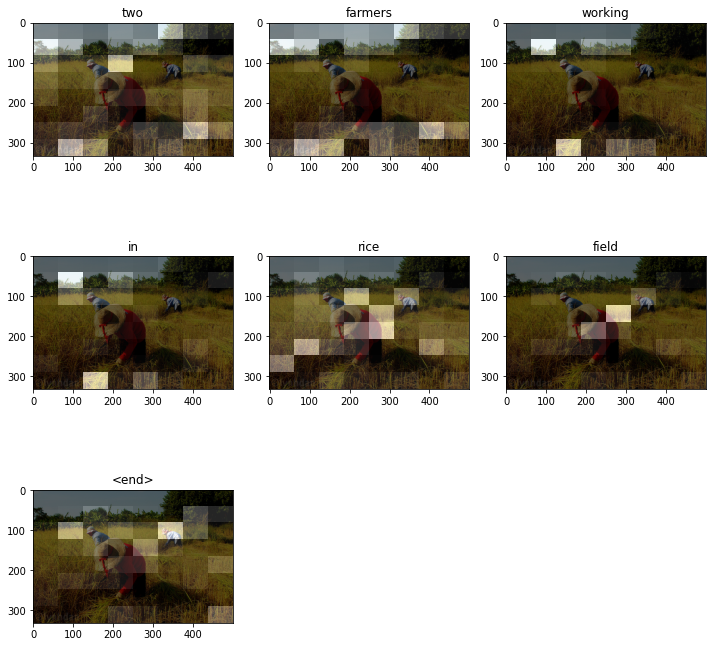

In [115]:
# captions on the validation set
rid = np.random.randint(0, len(img_name_val))
image = '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3083913737.jpg'

# real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

# remove <start> and <end> from the real_caption
real_caption = 'Two white dogs are playing in the snow'
first = real_caption.split(' ', 1)[1]
real_caption = 'Two white dogs are playing in the snow'

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

for i in real_caption:
   if i=="<unk>":
       real_caption.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result

score = sentence_bleu(reference, candidate)
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)
plot_attention(image, result, attention_plot)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
Real Caption: tan dog licks girls hand while laying down
Prediction Caption: the girl with the green scarf and the white dog appear to be playing


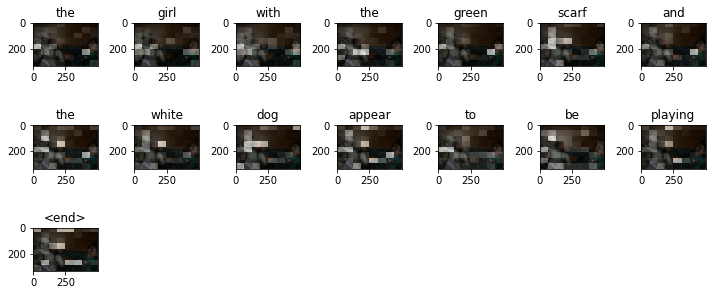

time took to Predict: 2 sec


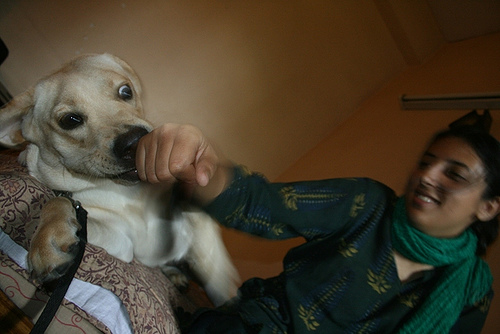

In [ ]:
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)
print(f"time took to Predict: {round(time.time()-start)} sec")

Image.open(img_name_val[rid])

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
BELU score: 5.74340400309589e-153
Real Caption: the girl is running on the sand near the beach
Prediction Caption: teenage girl running on beach shouting with an older man walking behind her


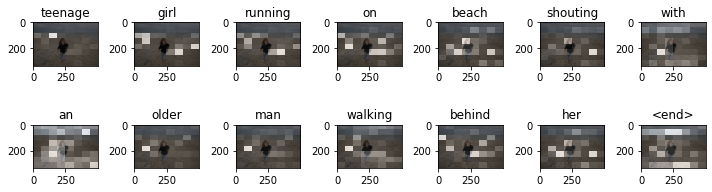

In [ ]:
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]

real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

# remove <start> and <end> from the real_caption
first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

for i in real_caption:
   if i=="<unk>":
       real_caption.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result

score = sentence_bleu(reference, candidate)
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

In [124]:
PATH1 = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/"

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


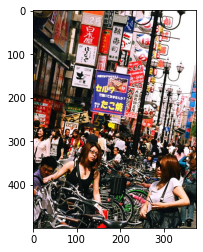

Real Caption: the woman in the black shirt attempts to find her bike in the midst of the crowded street
Prediction Caption: many people walking around sign displaying many different way street
BLEU-1 score: 4.811030377273184
BLEU-2 score: 2.3801627678128498e-153
BLEU-3 score: 6.601150548243757e-184
BLEU-4 score: 5.294085324363193e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


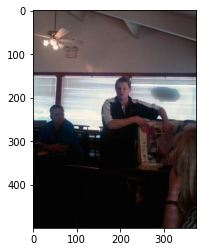

Real Caption: man is standing in room showing <unk>
Prediction Caption: two men working on the patio conversing with drinks
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


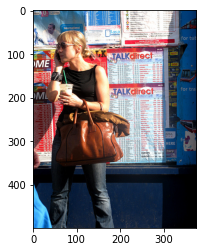

Real Caption: lady in black tank top talks on her cellphone
Prediction Caption: woman in white skirt and carrying baggage on the street holding shopping bag
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


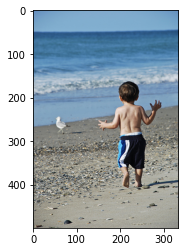

Real Caption: young boy chasing <unk> on the beach
Prediction Caption: boy in blue shorts is running towards seagull on beach
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


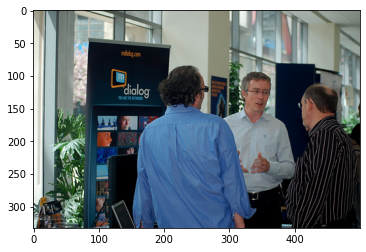

Real Caption: man explains display to two other men
Prediction Caption: group of men and man are checking on the subway
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


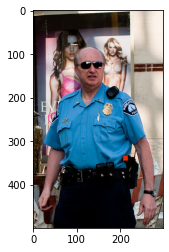

Real Caption: police officer is standing in front of poster
Prediction Caption: police officer stands in front of lingerie advertisement featuring two people
BLEU-1 score: 41.66666666666667
BLEU-2 score: 33.7099931231621
BLEU-3 score: 26.10088290788024
BLEU-4 score: 3.9876353728947066e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


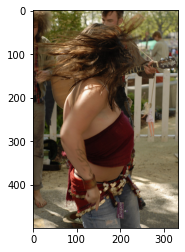

Real Caption: woman flips her hair as she dances outdoors band in background
Prediction Caption: woman in pink skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt and striped skirt
BLEU-1 score: 2.7027027027027026
BLEU-2 score: 2.452287326375221e-153
BLEU-3 score: 8.668543674587688e-184
BLEU-4 score: 7.386826398032373e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


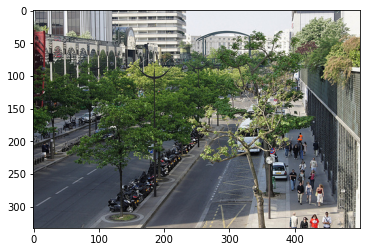

Real Caption: aerial view of pedestrians walking on the sidewalk of street in busy part of town with trees in the <unk>
Prediction Caption: two people walking on the line
BLEU-1 score: 6.690773370684473
BLEU-2 score: 5.900707472508166
BLEU-3 score: 5.37319611083459
BLEU-4 score: 7.839208251616036e-77
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


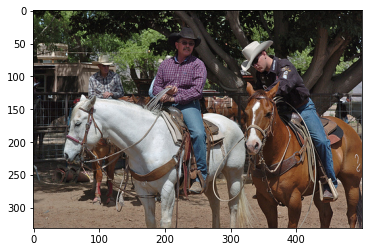

Real Caption: older man man and young man are each sitting on horse and looking in various directions in <unk> near large tree
Prediction Caption: man in jean jacket is sitting on horses
BLEU-1 score: 11.715428360698965
BLEU-2 score: 6.213044128766578
BLEU-3 score: 5.6048277303647985e-92
BLEU-4 score: 1.9089509973511697e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


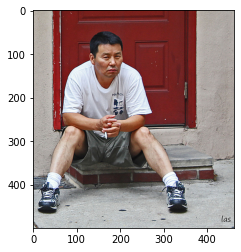

Real Caption: asian man smoking on porch
Prediction Caption: man in black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt and black shirt
BLEU-1 score: 1.351351351351352
BLEU-2 score: 1.734028997897795e-153
BLEU-3 score: 7.041045372602493e-184
BLEU-4 score: 6.211555838206664e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


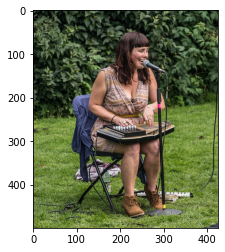

Real Caption: woman is singing into microphone while sitting and playing an instrument
Prediction Caption: woman in plaid skirt and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top and tank top
BLEU-1 score: 2.7027027027027026
BLEU-2 score: 2.452287326375221e-153
BLEU-3 score: 8.668543674587688e-184
BLEU-4 score: 7.386826398032373e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


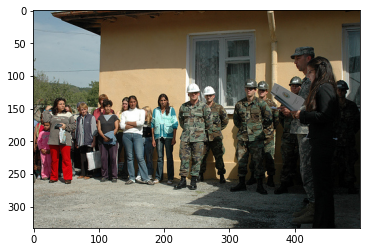

Real Caption: man from the army speaking with civilian women
Prediction Caption: group of people are gathered together
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


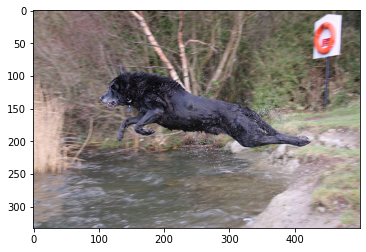

Real Caption: wet black dog jumping into lake
Prediction Caption: black dog is jumping in the woods
BLEU-1 score: 37.5
BLEU-2 score: 23.145502494313785
BLEU-3 score: 2.1032131949153637e-91
BLEU-4 score: 7.176381577237209e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


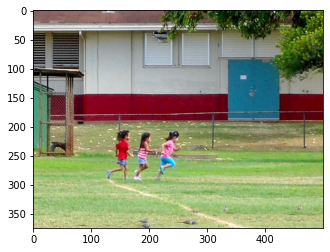

Real Caption: three girls run in field outside
Prediction Caption: two females one in red and two men in red jerseys are playing soccer in front of neighborhood
BLEU-1 score: 5.263157894736841
BLEU-2 score: 3.422121424610076e-153
BLEU-3 score: 1.0587186866676174e-183
BLEU-4 score: 8.726094729337945e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


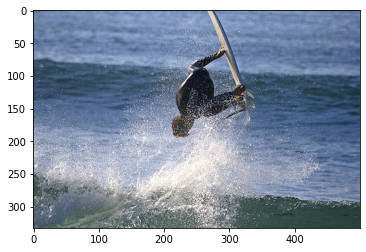

Real Caption: surfer does flip on wave
Prediction Caption: surfer rides wave on board in the water
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


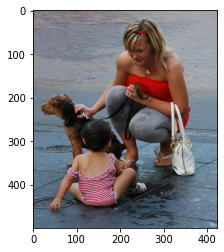

Real Caption: woman squatting to face small child while holding dog
Prediction Caption: woman and woman are playing on the beach
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


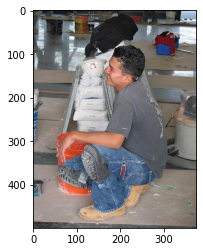

Real Caption: man is taking break from working hard
Prediction Caption: man in blue shirt and black hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat and orange hat
BLEU-1 score: 1.351351351351352
BLEU-2 score: 1.734028997897795e-153
BLEU-3 score: 7.041045372602493e-184
BLEU-4 score: 6.211555838206664e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


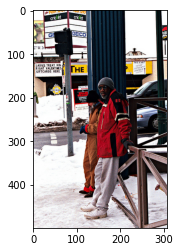

Real Caption: two men are standing outside in the snow
Prediction Caption: man in red coat and backpack and headphones poses with another man in red coat and backpack and headphones poses with another man in red coat and backpack and headphones poses with another man in red coat and backpack and headphones poses with another man in red coat and backpack and headphones poses with another man in red coat and backpack and headphones poses with another man in red coat and backpack and
BLEU-1 score: 1.351351351351352
BLEU-2 score: 1.734028997897795e-153
BLEU-3 score: 7.041045372602493e-184
BLEU-4 score: 6.211555838206664e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


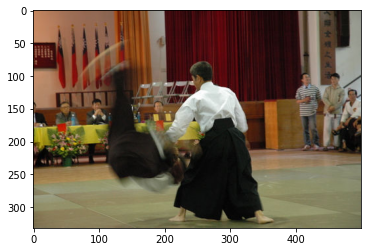

Real Caption: two men in martial arts uniforms perform for table of judges
Prediction Caption: two martial artists in martial arts uniforms
BLEU-1 score: 42.95557992443577
BLEU-2 score: 35.57059954491716
BLEU-3 score: 33.29462766193913
BLEU-4 score: 25.12421854739509
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


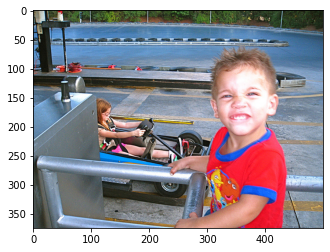

Real Caption: little boy is standing in line for
Prediction Caption: young boy is excited
BLEU-1 score: 26.812801841425575
BLEU-2 score: 21.19738106741542
BLEU-3 score: 1.7001433327133957e-91
BLEU-4 score: 5.622823133489599e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


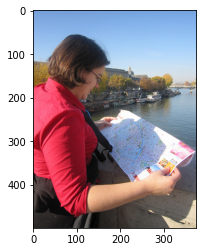

Real Caption: woman in red shirt is looking at map outdoors
Prediction Caption: woman in red looks at map
BLEU-1 score: 53.67694950537757
BLEU-2 score: 44.90935799743743
BLEU-3 score: 34.04689031443354
BLEU-4 score: 4.744822399347669e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


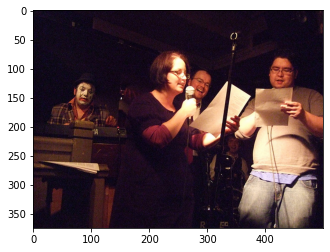

Real Caption: woman and men are singing into microphone
Prediction Caption: two men perform together
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


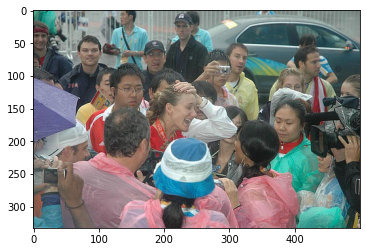

Real Caption: crowd gathers around woman <unk> her head
Prediction Caption: woman is showing off different
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


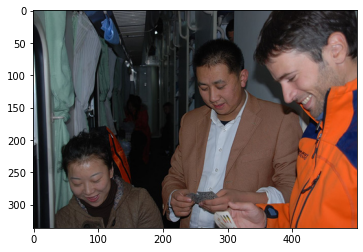

Real Caption: three people smiling while playing cards
Prediction Caption: two men are sitting and laughing
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


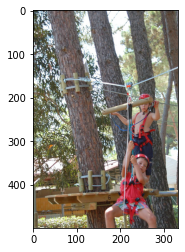

Real Caption: two boys are riding <unk> between trees
Prediction Caption: child is riding zip line of his index finger
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


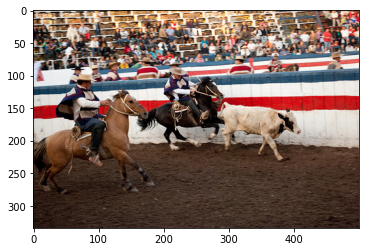

Real Caption: two men riding horses while wearing traditional <unk> wear and chasing down small calf in front of <unk> rodeo crowd
Prediction Caption: two cowboys are playing in fenced area
BLEU-1 score: 5.578254003710746
BLEU-2 score: 1.664180761794279e-153
BLEU-3 score: 3.7700485116849887e-184
BLEU-4 score: 2.8744291130001146e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


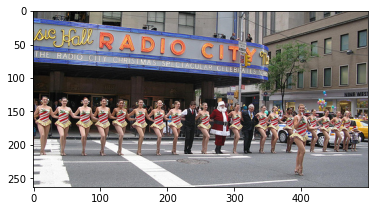

Real Caption: man in santa suit stands amid long row of dancers on new york city street
Prediction Caption: santa <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>
BLEU-1 score: 2.7027027027027026
BLEU-2 score: 2.452287326375221e-153
BLEU-3 score: 8.668543674587688e-184
BLEU-4 score: 7.386826398032373e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


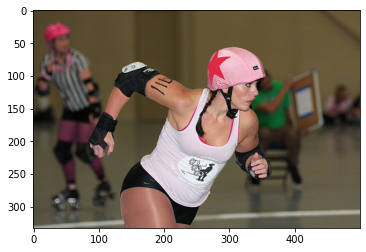

Real Caption: roller derby girl skating with <unk>
Prediction Caption: female runner in pink and purple shorts skates
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


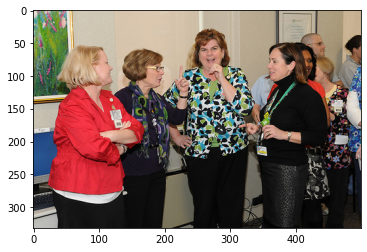

Real Caption: group of women talking with each other
Prediction Caption: four women interact with computer
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


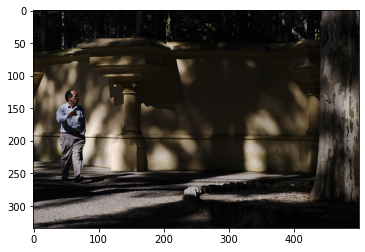

Real Caption: man in blue shirt and gray pants is walking on shady gravel path past structure
Prediction Caption: man in dark shirt is standing in the driveway
BLEU-1 score: 24.26122638850534
BLEU-2 score: 12.786789036109663
BLEU-3 score: 1.2061500329565798e-91
BLEU-4 score: 4.1541229402322545e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


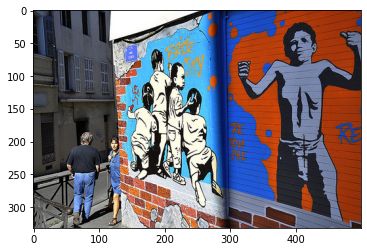

Real Caption: man and woman walking past brick wall covered in graffiti
Prediction Caption: man and woman are walking on the side of graffiti wall
BLEU-1 score: 50.0
BLEU-2 score: 30.15113445777636
BLEU-3 score: 24.410810226394986
BLEU-4 score: 3.7712726936794865e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


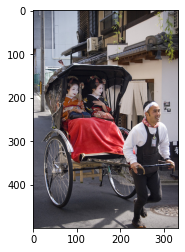

Real Caption: two chinese women in <unk> dress and makeup are being pulled in carriage by man
Prediction Caption: woman pulls off his bike on the street with man in shorts pulls off his bike on the street with man in shorts pulls off his bike on the street with man in shorts pulls off his bike on the street with man in shorts pulls off his bike on the street with man in shorts pulls off his bike on the street with man in shorts pulls off his bike on the
BLEU-1 score: 4.0540540540540535
BLEU-2 score: 3.0034263261566377e-153
BLEU-3 score: 9.789793233769279e-184
BLEU-4 score: 8.174867218666773e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


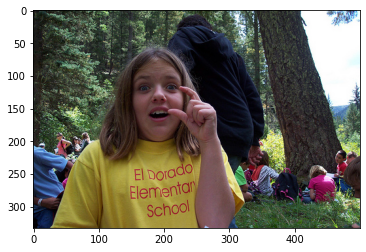

Real Caption: young girl with other people in the forest wearing yellow shirt surprised about something small
Prediction Caption: woman in blue shirt is standing next to man
BLEU-1 score: 12.13061319425267
BLEU-2 score: 4.04613130689749e-153
BLEU-3 score: 9.5844769350029e-184
BLEU-4 score: 7.389560029878221e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


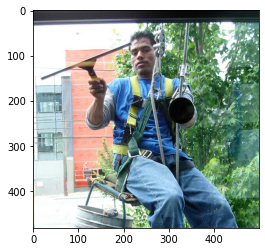

Real Caption: man in blue shirt cleaning windows from harness
Prediction Caption: man in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue shirt and woman in blue
BLEU-1 score: 5.405405405405406
BLEU-2 score: 4.713172478992737
BLEU-3 score: 5.458800839018001
BLEU-4 score: 3.0532787431362576
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


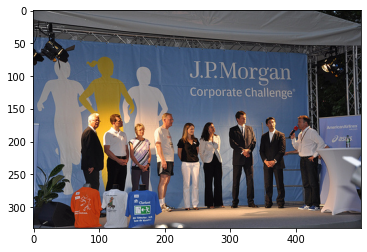

Real Caption: people waiting to speak into microphone at <unk> <unk> challenge
Prediction Caption: group of people at podium
BLEU-1 score: 17.113903967753068
BLEU-2 score: 4.421625271317475e-153
BLEU-3 score: 9.45672212180377e-184
BLEU-4 score: 7.107197028258988e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


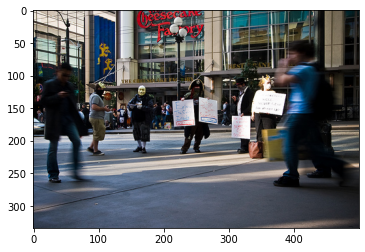

Real Caption: picture of two people in costume holding signs
Prediction Caption: group of people are walking on cold but
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


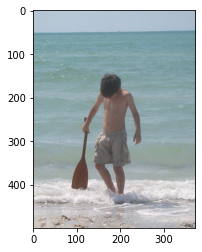

Real Caption: boy is on the beach with paddle in his hand as he walks through the ocean water
Prediction Caption: boy in blue shorts is walking through the ocean
BLEU-1 score: 29.79511822748457
BLEU-2 score: 18.13273150747404
BLEU-3 score: 14.539467049209575
BLEU-4 score: 2.1791752508374897e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


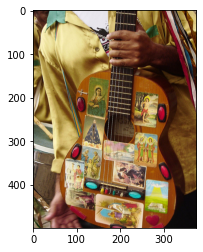

Real Caption: the guitar is covered in <unk> depicting religious <unk>
Prediction Caption: man is playing guitar
BLEU-1 score: 17.973158564688863
BLEU-2 score: 4.239031324788977e-153
BLEU-3 score: 8.741562574645582e-184
BLEU-4 score: 6.510101141652544e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


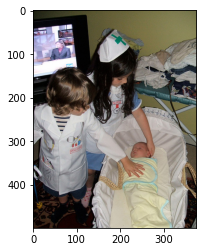

Real Caption: two children dressed as medical professionals touch baby while television is on in the background
Prediction Caption: two children two children are sitting on the table
BLEU-1 score: 24.26122638850534
BLEU-2 score: 12.786789036109663
BLEU-3 score: 1.2061500329565798e-91
BLEU-4 score: 4.1541229402322545e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


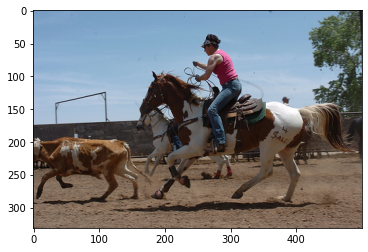

Real Caption: man in pink shirt and blue jeans rides horse
Prediction Caption: man in white shirt and dust
BLEU-1 score: 42.94155960430205
BLEU-2 score: 32.797157891028675
BLEU-3 score: 2.3124449392610116e-91
BLEU-4 score: 7.405395403197815e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


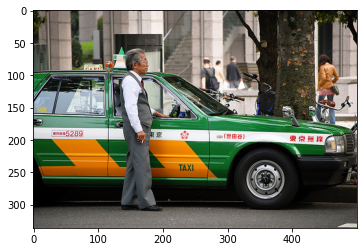

Real Caption: older man standing next to green yellow and white taxi
Prediction Caption: man in sunglasses is standing next to red and yellow taxi
BLEU-1 score: 58.333333333333336
BLEU-2 score: 32.56694736394648
BLEU-3 score: 25.56620290415526
BLEU-4 score: 3.919445536306192e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


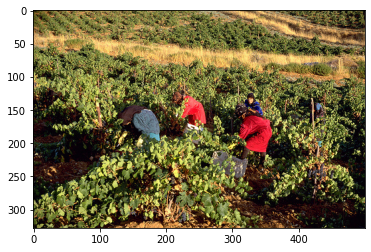

Real Caption: four people wearing jackets in large field
Prediction Caption: four people harvesting crops
BLEU-1 score: 26.812801841425575
BLEU-2 score: 21.19738106741542
BLEU-3 score: 1.7001433327133957e-91
BLEU-4 score: 5.622823133489599e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


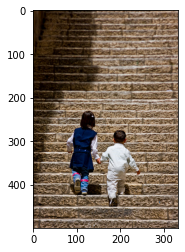

Real Caption: young boy and girl ascending staircase
Prediction Caption: two children are climbing up the staircase
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


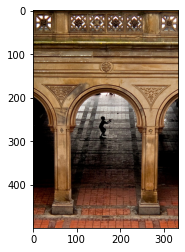

Real Caption: kid is in the ready position under building and behind an archway
Prediction Caption: person in red shirt is standing on the gravel track
BLEU-1 score: 24.902746807698065
BLEU-2 score: 7.113038902664186e-153
BLEU-3 score: 1.5835942390985683e-183
BLEU-4 score: 1.2021513525930774e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


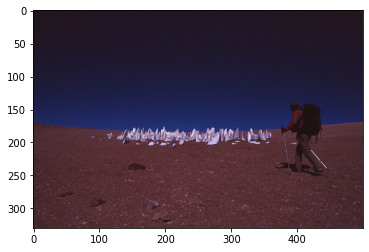

Real Caption: hiker passes white rock formation in the middle of an empty desert
Prediction Caption: man hiking with backpack on cloudy day
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


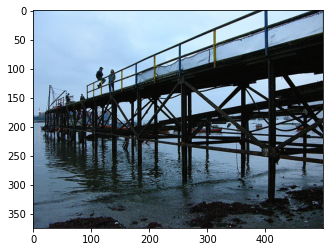

Real Caption: in the evening or dark light few people wait on pier with boat in the background
Prediction Caption: two people are climbing on dock
BLEU-1 score: 7.898658475130412
BLEU-2 score: 2.2042435261229696e-153
BLEU-3 score: 4.861917956276235e-184
BLEU-4 score: 3.682245099646241e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


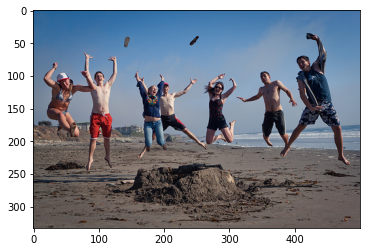

Real Caption: group of people jumping into the air at the beach
Prediction Caption: seven people are caught on beach
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


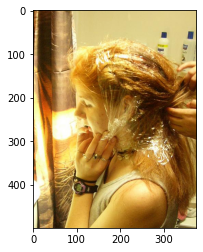

Real Caption: lady getting her hair done
Prediction Caption: girl with glasses is making face
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


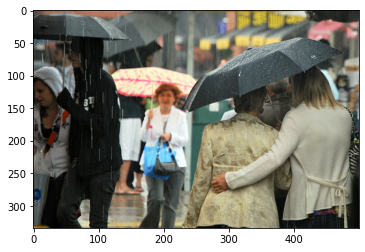

Real Caption: two older women are walking together under an umbrella in the pouring rain on busy street
Prediction Caption: woman in black jacket is walking under umbrella
BLEU-1 score: 20.41892551270785
BLEU-2 score: 4.5687391151632425e-153
BLEU-3 score: 9.225019787321365e-184
BLEU-4 score: 6.8340491359230455e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


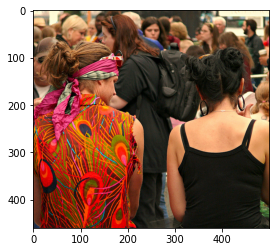

Real Caption: the back view of woman in colorful shirt sitting next to woman in black top
Prediction Caption: group of people are facing away from the camera
BLEU-1 score: 12.13061319425267
BLEU-2 score: 4.04613130689749e-153
BLEU-3 score: 9.5844769350029e-184
BLEU-4 score: 7.389560029878221e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


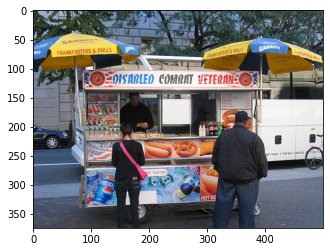

Real Caption: girl with pink handbag buying hotdog at hotdog cart
Prediction Caption: man and woman stand at the street named entrance
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


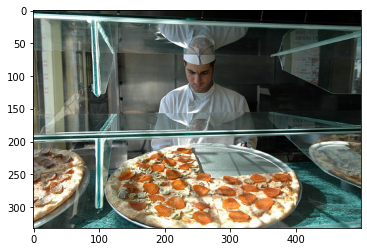

Real Caption: chef standing behind large pan of <unk> pizza with of the pizza missing
Prediction Caption: chef is concentrating on pizza out of pizza
BLEU-1 score: 28.496906152442424
BLEU-2 score: 6.376189076098649e-153
BLEU-3 score: 1.2874552236850733e-183
BLEU-4 score: 9.537683887743055e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


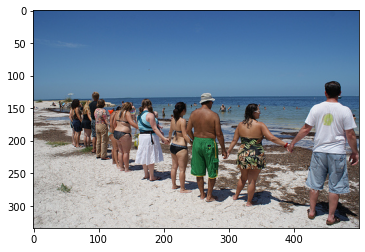

Real Caption: about dozen people are standing on beach holding hands and looking out over the water
Prediction Caption: group of people are playing in chairs on the beach
BLEU-1 score: 31.59745129085813
BLEU-2 score: 14.820518350489417
BLEU-3 score: 1.3917180472365593e-91
BLEU-4 score: 4.787858197212754e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


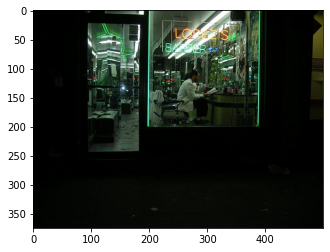

Real Caption: man reads the paper in bar with green lighting
Prediction Caption: an old man in white shirt is at the window
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


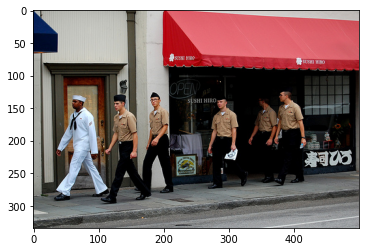

Real Caption: group of <unk> are walking along sidewalk in line
Prediction Caption: group of people are walking down the sidewalk
BLEU-1 score: 55.55555555555556
BLEU-2 score: 37.2677996249965
BLEU-3 score: 2.799004395628975e-91
BLEU-4 score: 9.106239987484608e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


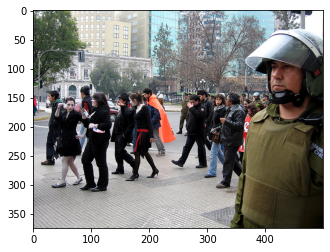

Real Caption: crowd of people crossing street
Prediction Caption: man keeps order
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


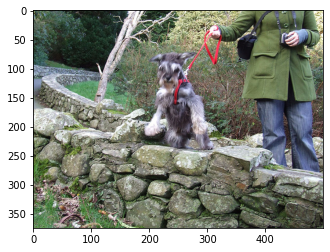

Real Caption: dog on leash jumps over stone wall
Prediction Caption: dog with burgundy and dog are standing next to wall
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


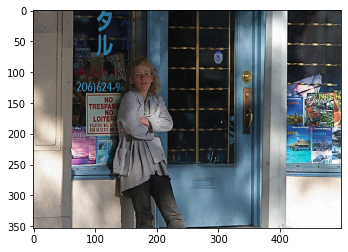

Real Caption: woman leaning on doorway to store
Prediction Caption: woman in black coat is standing in front of store
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


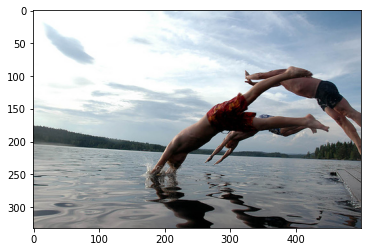

Real Caption: three young men wearing colorful swim trunks are diving into the water
Prediction Caption: three boys diving into the water
BLEU-1 score: 34.967261396925224
BLEU-2 score: 29.25570984817542
BLEU-3 score: 27.306135676293408
BLEU-4 score: 21.281397709599684
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


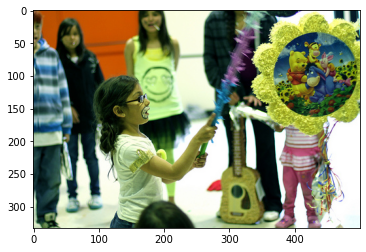

Real Caption: little girl with makeup on her face hits pinata with stick while others look on
Prediction Caption: two girls show
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


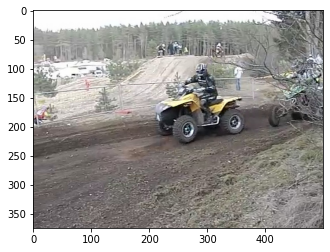

Real Caption: couple of people are riding atv on dirt track
Prediction Caption: man driving atv in the desert road
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


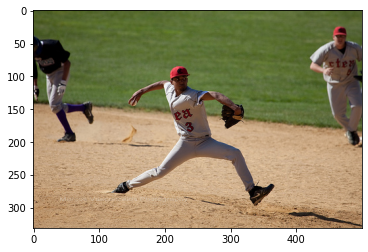

Real Caption: baseball player not the pitcher is winding up to throw the ball to another player
Prediction Caption: pitcher in white uniform is about to throw ball
BLEU-1 score: 30.326532985631673
BLEU-2 score: 14.296064749345112
BLEU-3 score: 1.2896573480176955e-91
BLEU-4 score: 4.392450221800856e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


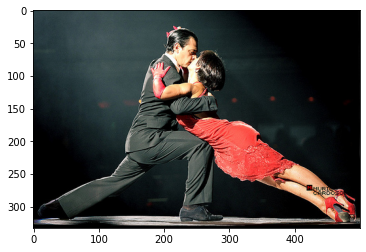

Real Caption: woman in <unk> red dress and man in suit dance <unk> together
Prediction Caption: man and woman in costume
BLEU-1 score: 24.525296078096154
BLEU-2 score: 13.433057891466246
BLEU-3 score: 1.0171627996810396e-91
BLEU-4 score: 3.3159839357976687e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


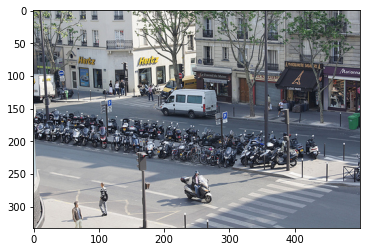

Real Caption: motorcyclist stops at an empty crosswalk while <unk> or <unk> motorcycles and bicycles sit parked in the street beside him
Prediction Caption: people are walking on the street
BLEU-1 score: 4.460515580456316
BLEU-2 score: 3.406775047661826
BLEU-3 score: 3.1694991967191616e-92
BLEU-4 score: 1.0878537096719418e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


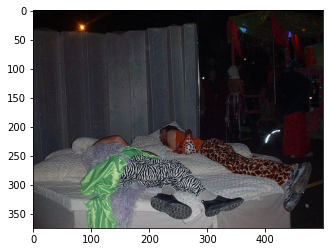

Real Caption: two people with animal print pants laying on bed next to each other
Prediction Caption: two older women are sitting down
BLEU-1 score: 6.062469223956427
BLEU-2 score: 2.392603769591812e-153
BLEU-3 score: 6.062124254323657e-184
BLEU-4 score: 4.753148692240233e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


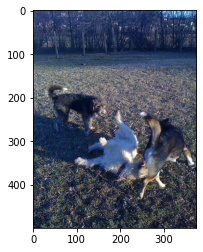

Real Caption: three dogs play with each other out in the field
Prediction Caption: three dogs wrestle in the grass
BLEU-1 score: 37.225089001774606
BLEU-2 score: 28.431131350350043
BLEU-3 score: 2.0046074122345223e-91
BLEU-4 score: 6.419573613943771e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


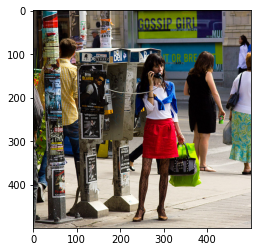

Real Caption: woman with skirt and high heels using pay phone outside
Prediction Caption: woman in red skirt is carrying handbag on the street
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


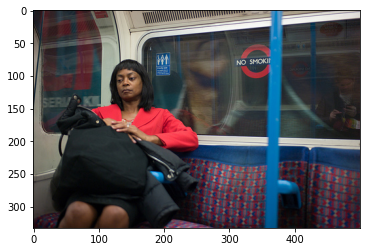

Real Caption: woman in red dress sitting on subway
Prediction Caption: pair of hand on her lap perhaps dressed in car
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


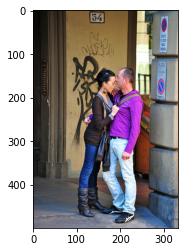

Real Caption: man and woman embracing on the sidewalk
Prediction Caption: man and woman are walking outside
BLEU-1 score: 42.857142857142854
BLEU-2 score: 37.79644730092272
BLEU-3 score: 34.41752104927812
BLEU-4 score: 5.021333847570327e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


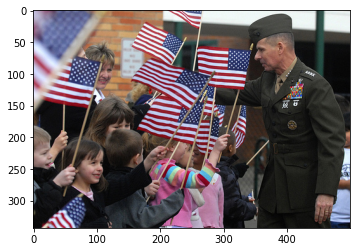

Real Caption: military man says hello to group of children waving american flags
Prediction Caption: group of soldiers in uniform holding gun crying
BLEU-1 score: 17.794164509262398
BLEU-2 score: 13.3456233819468
BLEU-3 score: 1.382937949398001e-91
BLEU-4 score: 4.876258334835267e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


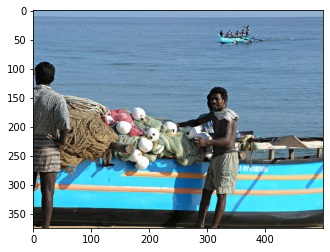

Real Caption: three or two fishermen are standing next to very bright aqua colored boat with yellow <unk> that has <unk> ropes and nets and an identical boat with people in the water in the distance
Prediction Caption: three people are sitting on the beach
BLEU-1 score: 1.9387103915861004
BLEU-2 score: 4.089781929485872e-154
BLEU-3 score: 8.065672687626745e-185
BLEU-4 score: 5.940100029848595e-231
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


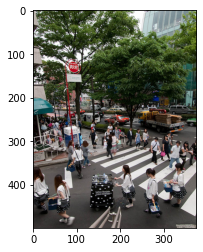

Real Caption: there are many people outside including group of girls all wearing polka dot skirts
Prediction Caption: people walking down the street fair
BLEU-1 score: 5.255420588163462
BLEU-2 score: 2.0740953307181176e-153
BLEU-3 score: 5.255121541612728e-184
BLEU-4 score: 4.120399555529536e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


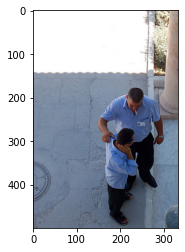

Real Caption: two guys in blue shirts talking
Prediction Caption: two men wearing blue shirts and white shirts are playing in the background
BLEU-1 score: 28.57142857142857
BLEU-2 score: 14.824986333222023
BLEU-3 score: 1.6099037441710956e-91
BLEU-4 score: 5.74340400309589e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


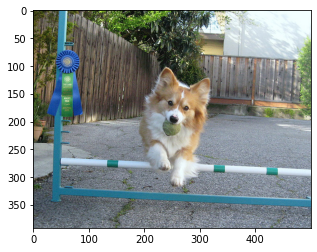

Real Caption: dog jumps over bar with ball in its mouth
Prediction Caption: brown and white dog jumping over pole
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


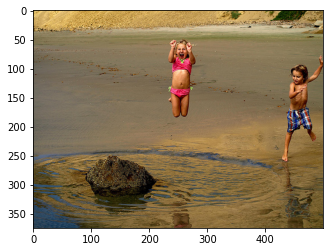

Real Caption: little girl and boy are playing in the water
Prediction Caption: three children are sitting on the backs
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


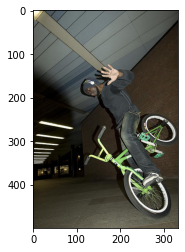

Real Caption: man performs <unk> trick on his bmx green bicycle with no hands
Prediction Caption: man in green flies through the air
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


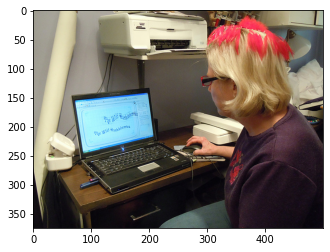

Real Caption: woman wearing red feather hat is using laptop
Prediction Caption: woman in red sweatshirt and jeans is sitting in front of him
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


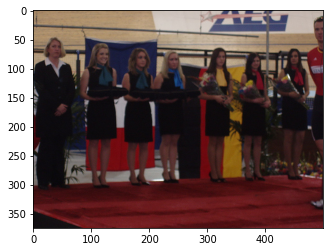

Real Caption: there is woman in suit three women in little black dresses and blue scarves one woman in little black dress and yellow scarf and two women in little black dresses and red scarves all standing on red stage
Prediction Caption: group of women pose in row of them
BLEU-1 score: 0.8859192849716652
BLEU-2 score: 2.8033196951833574e-154
BLEU-3 score: 6.502039060175387e-185
BLEU-4 score: 4.986684185455999e-231
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


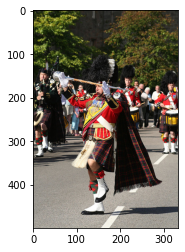

Real Caption: photo is of scottish parade leader followed by his troupe while they all march down the street
Prediction Caption: man in scottish garb dressed in red and red costume is walking through street
BLEU-1 score: 17.50346638085895
BLEU-2 score: 5.83823110742459e-153
BLEU-3 score: 1.3829603427584735e-183
BLEU-4 score: 1.06625208042734e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


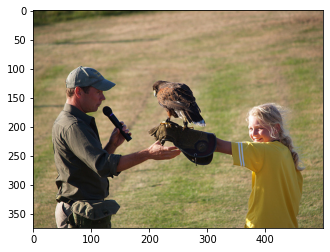

Real Caption: girl has <unk> resting on her hand and man with microphone is talking to her while looking at the bird
Prediction Caption: young woman and woman in park is flipping someone glove on his arm
BLEU-1 score: 13.959408375665475
BLEU-2 score: 4.49823995384258e-153
BLEU-3 score: 1.050941200075795e-183
BLEU-4 score: 8.074774851980488e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


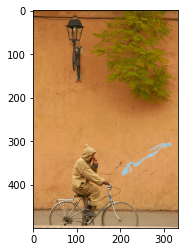

Real Caption: man rides his bike while picking his nose
Prediction Caption: man in suit riding bike
BLEU-1 score: 23.88437701912631
BLEU-2 score: 6.17087516772532e-153
BLEU-3 score: 1.319791889377583e-183
BLEU-4 score: 9.918892480173173e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


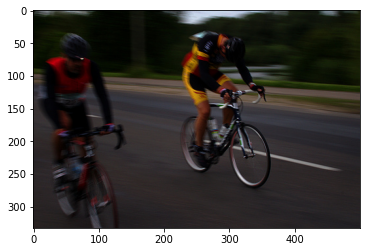

Real Caption: two bicycle riders are speeding over paved road
Prediction Caption: two people are competing in bike race
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


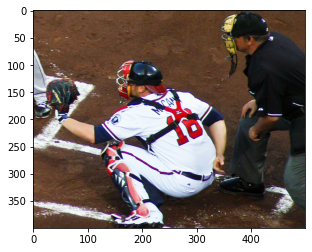

Real Caption: an umpire and catcher diligently wait for the batter next <unk> ball
Prediction Caption: baseball catcher in blue jersey is running with one in blue jersey is running with one in blue jersey is running with one in blue jersey is running with one in blue jersey is running with one in blue jersey is running with one in blue jersey is running with one in blue jersey is running with one in blue jersey is running with one in blue jersey is running with one in
BLEU-1 score: 1.351351351351352
BLEU-2 score: 1.734028997897795e-153
BLEU-3 score: 7.041045372602493e-184
BLEU-4 score: 6.211555838206664e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


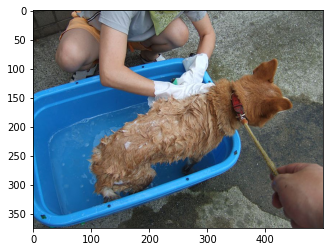

Real Caption: small brown dog is being washed in small blue bin
Prediction Caption: brown dog is his dog bath
BLEU-1 score: 27.91881675133095
BLEU-2 score: 24.622082007735305
BLEU-3 score: 22.420917474897006
BLEU-4 score: 3.271092989210003e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


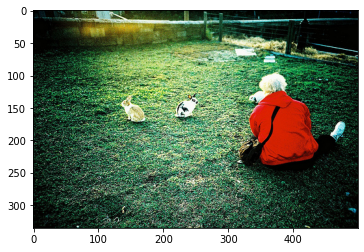

Real Caption: woman is laying on the grass with rabbits
Prediction Caption: man in red shirt is sitting in the grass
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


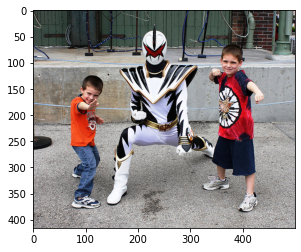

Real Caption: man in costume poses with two young boys
Prediction Caption: two young boys are jogging together
BLEU-1 score: 37.1519099892935
BLEU-2 score: 32.76490485424231
BLEU-3 score: 29.835788361805886
BLEU-4 score: 4.352883339726264e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


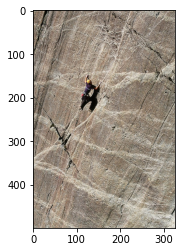

Real Caption: man climbing sheer rock wall
Prediction Caption: rock climber looked very very steep mountainside
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


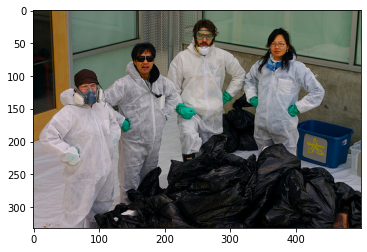

Real Caption: four person clean up crew with <unk> gloves and masks
Prediction Caption: four people in suits all wearing vests are standing around pile of trash bags
BLEU-1 score: 6.666666666666667
BLEU-2 score: 3.851470592303926e-153
BLEU-3 score: 1.1365257532669032e-183
BLEU-4 score: 9.25732495472854e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


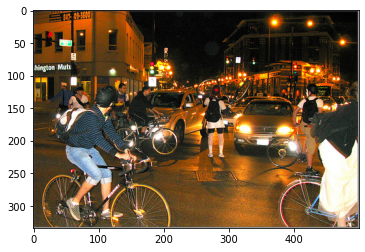

Real Caption: several bike riders are attempting to cross the street and are also holding up traffic with their bikes
Prediction Caption: man in tank top and white outfit is sitting on bike
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


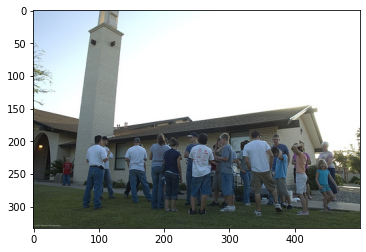

Real Caption: people standing outside of building
Prediction Caption: group of people are posed with castle
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


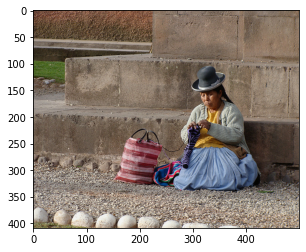

Real Caption: an old woman with gray hat sits on the gravel covered ground in front of large stone blocks knitting <unk>
Prediction Caption: an elderly woman sitting on the ground playing the ground next to rock bench
BLEU-1 score: 23.88437701912631
BLEU-2 score: 11.056318157426373
BLEU-3 score: 1.1815815881139173e-91
BLEU-4 score: 4.198508780749403e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


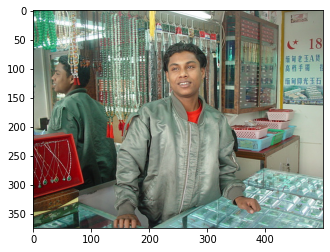

Real Caption: man in an olive colored coat is standing in jewelry store
Prediction Caption: man in red bearing the other is looking at jewelry store
BLEU-1 score: 41.66666666666667
BLEU-2 score: 27.524094128159014
BLEU-3 score: 2.3336254371206134e-91
BLEU-4 score: 7.825799788115097e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


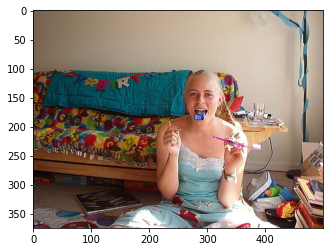

Real Caption: young girl with blond braided hair sits in the floor holding pink toothbrush with happy birthday banner on the back of the sofa behind her
Prediction Caption: girl with pink toothbrush in her mouth
BLEU-1 score: 8.957472620003971
BLEU-2 score: 5.528672129841317
BLEU-3 score: 3.807373835589071e-92
BLEU-4 score: 1.2121175697761418e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


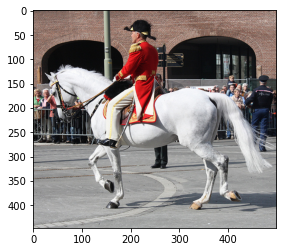

Real Caption: man in red and gold uniform and black cap sits on an <unk> saddle and blanket on pale gray horse as it trots along gray road while onlookers watch between low metal barrier and brick building
Prediction Caption: man in blue jacket riding white horse
BLEU-1 score: 1.1324018783369436
BLEU-2 score: 0.6989336133230226
BLEU-3 score: 6.3511535265738734e-93
BLEU-4 score: 2.1670794607269478e-154
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


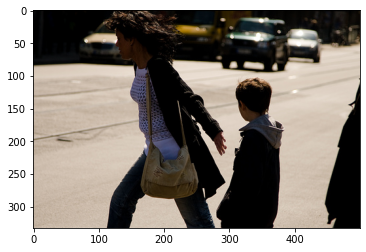

Real Caption: woman reaches for boy hand as she crosses the street
Prediction Caption: woman in black sweater and dark clothing is holding bouquet of
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


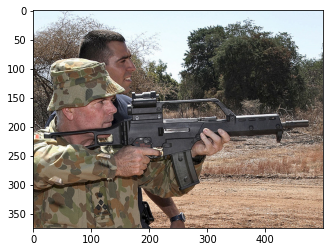

Real Caption: man in camouflage holds large gun with another man behind him as both look in the direction of the gun barrel
Prediction Caption: man in camouflage is filming it is holding camera
BLEU-1 score: 9.986132510942387
BLEU-2 score: 8.594694423977845
BLEU-3 score: 7.916290011242872
BLEU-4 score: 1.2283351117166399e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


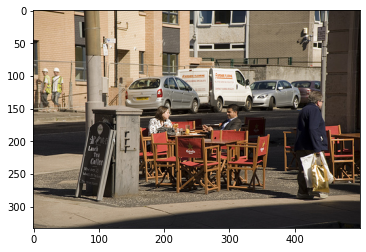

Real Caption: there is man and woman seated at table with red chairs outside on street corner while man in navy jacket walks by carrying bags
Prediction Caption: man and woman are talking on sewing machine
BLEU-1 score: 8.394471237224971
BLEU-2 score: 6.295853427918729
BLEU-3 score: 5.4497138428847585
BLEU-4 score: 8.187981146332927e-77
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


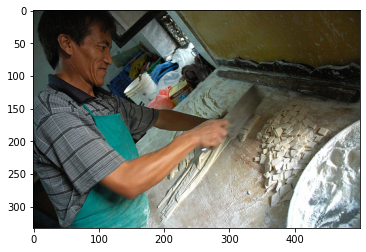

Real Caption: man is cutting dough into small square strips
Prediction Caption: man is cutting dough
BLEU-1 score: 43.90493088752211
BLEU-2 score: 42.51076653594019
BLEU-3 score: 41.69090362107932
BLEU-4 score: 36.70124608961283
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


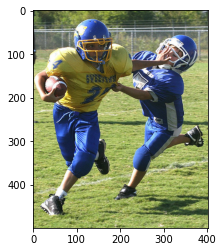

Real Caption: the young football player is trying to avoid being tackled
Prediction Caption: two football players on the ball
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


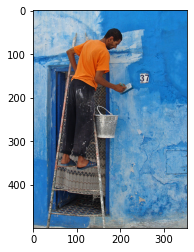

Real Caption: man painting house blue
Prediction Caption: man in red shirt is doing board
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


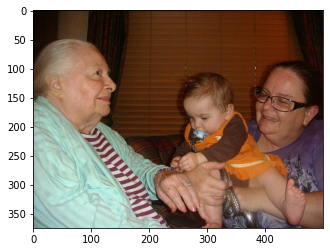

Real Caption: two women are holding young child
Prediction Caption: two women are laughing
BLEU-1 score: 49.12384518467891
BLEU-2 score: 44.8437301984003
BLEU-3 score: 41.03374012207271
BLEU-4 score: 5.623118184955381e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


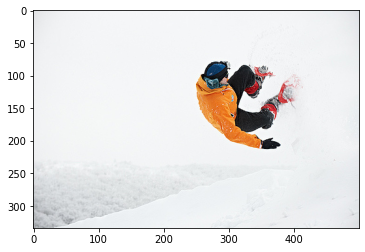

Real Caption: person in an orange jacket jumping in the air in the snow
Prediction Caption: snowboarder in the white coat is in the middle of hill
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 2.1825195678664249e-91
BLEU-4 score: 7.401184483348608e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


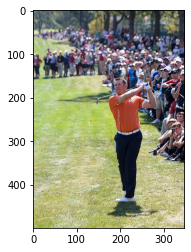

Real Caption: golfer watches his hit after he swings while several onlookers watch in the background
Prediction Caption: man in blue jeans is walking through the grass
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


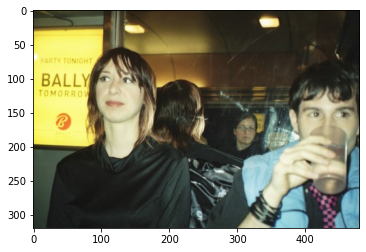

Real Caption: man in blue shirt is having drink next to lady
Prediction Caption: woman in brown shirt and dark brown shirt is laughing
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


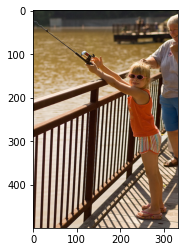

Real Caption: young girl is fishing with some elderly people possibly her <unk>
Prediction Caption: photographer in sunglasses fishes in the water
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


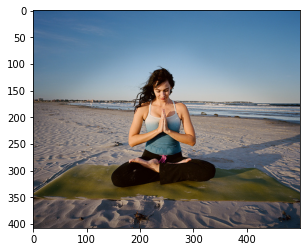

Real Caption: young lady doing yoga on the beach
Prediction Caption: woman is sitting on the beach
BLEU-1 score: 42.857142857142854
BLEU-2 score: 37.79644730092272
BLEU-3 score: 34.41752104927812
BLEU-4 score: 5.021333847570327e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


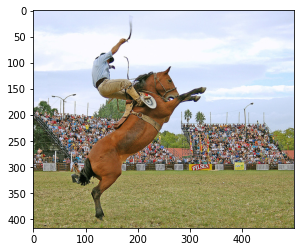

Real Caption: horse has bucked in an arena and the rider is coming off of its back in midair in front of crowd in the stands
Prediction Caption: man in black and white dog is catching the ball
BLEU-1 score: 11.153474820965702
BLEU-2 score: 2.7589812803933245e-153
BLEU-3 score: 5.798954961186038e-184
BLEU-4 score: 4.339283601389722e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


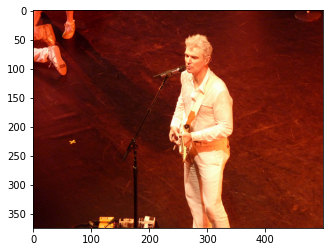

Real Caption: blond singer playing guitar
Prediction Caption: man in white outfit and tie sings
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


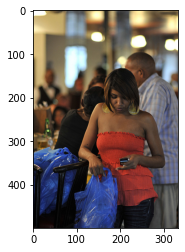

Real Caption: black or african <unk> woman wearing an orange blouse with large earrings is checking her or looking at her cellphone while carrying bag next to bag in chair with man behind her in blue shirt
Prediction Caption: young woman with purple earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings is wearing blue earrings
BLEU-1 score: 8.108108108108107
BLEU-2 score: 3.3327162207975753
BLEU-3 score: 6.574796731493522e-92
BLEU-4 score: 2.72314886495759e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


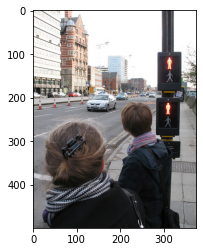

Real Caption: women wearing scarves waiting for the light to change so they can cross the street
Prediction Caption: two women are looking at the entrance
BLEU-1 score: 10.42155049196271
BLEU-2 score: 3.1090989806586375e-153
BLEU-3 score: 7.043377891278847e-184
BLEU-4 score: 5.370140570287953e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


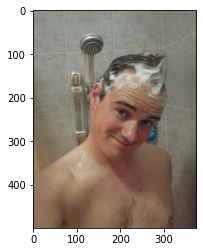

Real Caption: guy in the shower made mohawk out of his hair with <unk>
Prediction Caption: man with glasses brushing soap
BLEU-1 score: 6.1313240195240395
BLEU-2 score: 2.2402790036937483e-153
BLEU-3 score: 5.503852693656168e-184
BLEU-4 score: 4.282289549833951e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


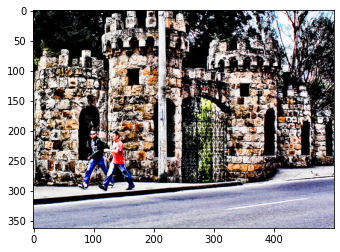

Real Caption: two men in jeans are walking near large stone wall
Prediction Caption: two men are walking down city street
BLEU-1 score: 38.94003915357025
BLEU-2 score: 29.4359027552757
BLEU-3 score: 2.1983675100964736e-91
BLEU-4 score: 7.142069717037071e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


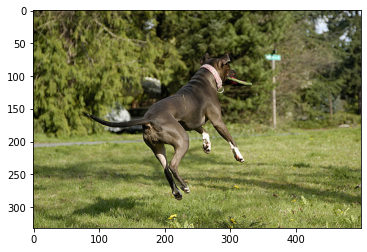

Real Caption: dog leaps high in the air to catch toy over the green grass
Prediction Caption: brown dog is jumping in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in midair catching ball in
BLEU-1 score: 2.7027027027027026
BLEU-2 score: 2.452287326375221e-153
BLEU-3 score: 8.668543674587688e-184
BLEU-4 score: 7.386826398032373e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


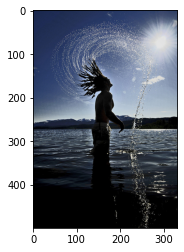

Real Caption: mail is swinging his wet hair around in the ocean
Prediction Caption: man waist performs trick in spiral
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


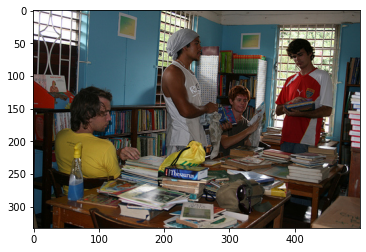

Real Caption: group of boys studying in library
Prediction Caption: four men wearing orange vests and orange vests and orange vests and books at books
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


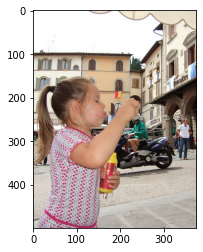

Real Caption: little girl blowing bubbles
Prediction Caption: little girl with pink dress blows her left arm around her back
BLEU-1 score: 15.384615384615385
BLEU-2 score: 11.322770341445958
BLEU-3 score: 1.36954071726339e-91
BLEU-4 score: 5.019362538473706e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


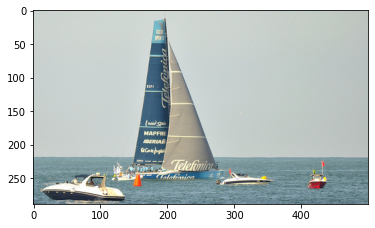

Real Caption: bunch of boats in the nice blue water
Prediction Caption: two men are working on the ocean
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


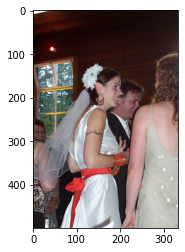

Real Caption: at wedding bride with pink sash is talking with guests
Prediction Caption: bride and woman are getting married outside
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


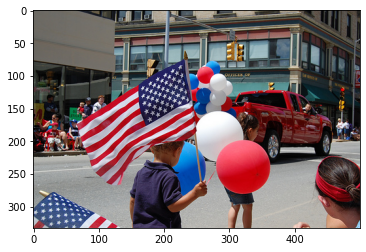

Real Caption: parents and kids celebrating at parade
Prediction Caption: the man is carrying red and purple balloons on the playground
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


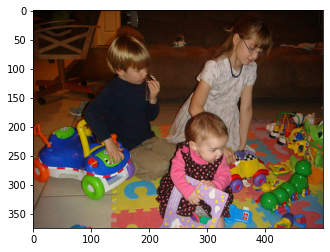

Real Caption: three young children playing with colourful toys
Prediction Caption: two children are playing with toys
BLEU-1 score: 57.14285714285714
BLEU-2 score: 30.860669992418384
BLEU-3 score: 2.499462007255115e-91
BLEU-4 score: 8.286571670851009e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


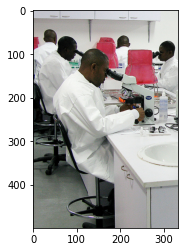

Real Caption: group of african american males in lab coats looking through microscopes
Prediction Caption: three black men are working in the background
BLEU-1 score: 8.897082254631197
BLEU-2 score: 3.981448258113331e-153
BLEU-3 score: 1.0607768203596798e-183
BLEU-4 score: 8.42243777956461e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


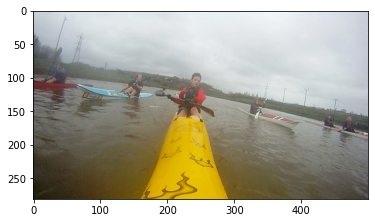

Real Caption: several men are kayaking in blue and yellow kayaks
Prediction Caption: people standing on the reflective yellow ship
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


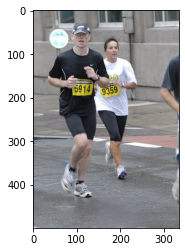

Real Caption: man and woman running in white tennis shoes with numbers on their <unk>
Prediction Caption: man in tank top is photographed by man in jeans and boots walks in the street
BLEU-1 score: 17.647058823529413
BLEU-2 score: 6.266259591476803e-153
BLEU-3 score: 1.5219779440726288e-183
BLEU-4 score: 1.1808001696991507e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


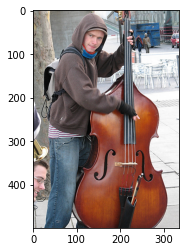

Real Caption: man in brown hooded sweatshirt outdoors with an upright bass playing the strings with his fingers
Prediction Caption: man wearing hat smiles as she looks like gym
BLEU-1 score: 5.488116360940265
BLEU-2 score: 2.5887822760123025e-153
BLEU-3 score: 7.044172291316346e-184
BLEU-4 score: 5.622528097505664e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


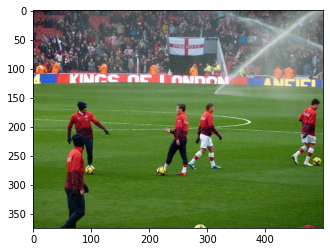

Real Caption: four men on soccer field while the sprinkler is on
Prediction Caption: soccer players rush towards the ball
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


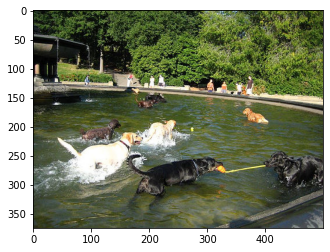

Real Caption: group of dogs playing in large pool
Prediction Caption: three dogs are in the water
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


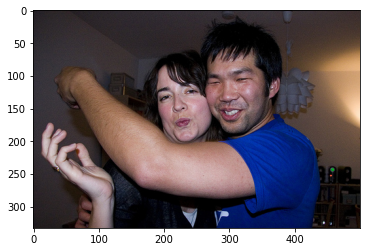

Real Caption: man and woman making funny faces for picture
Prediction Caption: man and woman posing for picture
BLEU-1 score: 61.91984998215584
BLEU-2 score: 51.80586332905649
BLEU-3 score: 39.27530085176383
BLEU-4 score: 5.473461026881688e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


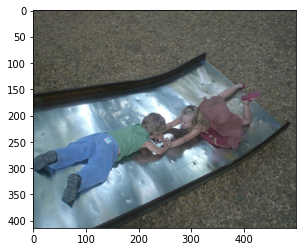

Real Caption: two children slide down slide
Prediction Caption: man and woman lying on huge cement slide
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


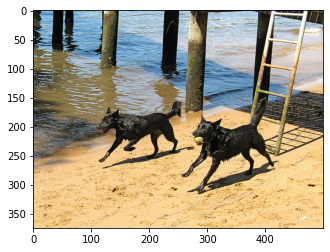

Real Caption: two black dogs run in the sand by pier
Prediction Caption: two black dogs run through the sea
BLEU-1 score: 55.156056411537215
BLEU-2 score: 45.673553902495044
BLEU-3 score: 42.75114815708459
BLEU-4 score: 32.260135189272866
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


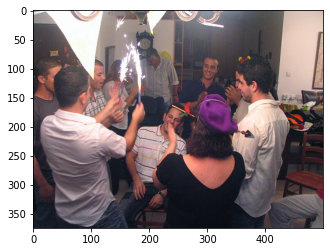

Real Caption: group of young people celebrate with one another
Prediction Caption: group of people sitting around table
BLEU-1 score: 37.1519099892935
BLEU-2 score: 23.168286407366764
BLEU-3 score: 1.9875719080152112e-91
BLEU-4 score: 6.68494960953009e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


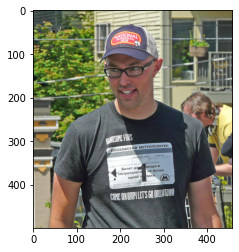

Real Caption: man with blue and white <unk> style hat with logo is wearing glasses in front of man with yellow shirt
Prediction Caption: man with glasses and striped shirt is wearing shirt and
BLEU-1 score: 28.07847431199898
BLEU-2 score: 15.741127130260175
BLEU-3 score: 1.20307329228821e-91
BLEU-4 score: 3.9311915398079405e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


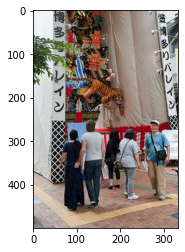

Real Caption: group takes in an area decorated in asian culture
Prediction Caption: man in brown hat is waiting at an outdoor market
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


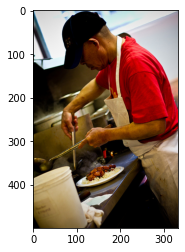

Real Caption: cook preparing meal in kitchen
Prediction Caption: woman in the red shirt is preparing food
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


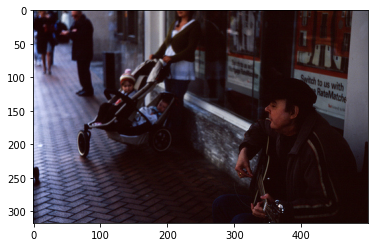

Real Caption: man sitting on sidewalk playing guitar
Prediction Caption: man plays an odd instrument
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


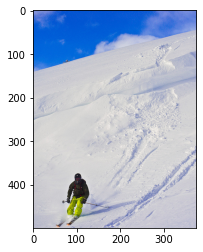

Real Caption: skier in yellow pants goes down slope
Prediction Caption: climber wearing blue ski jacket and helmet is skiing downhill
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


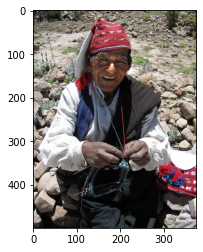

Real Caption: old man sits on rocks while working with his hands
Prediction Caption: an old man with red hat sits on rocks
BLEU-1 score: 60.0
BLEU-2 score: 44.721359549995796
BLEU-3 score: 33.066025977478425
BLEU-4 score: 4.856474469839072e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


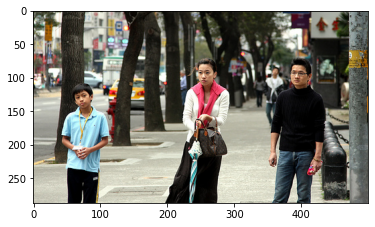

Real Caption: three asian people wait on the sidewalk
Prediction Caption: two women walking and talking
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


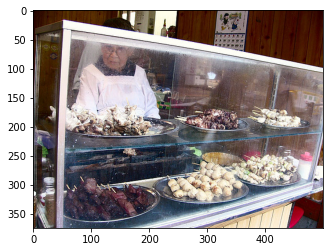

Real Caption: woman stands behind clear counter behind large display of <unk>
Prediction Caption: woman is preparing food
BLEU-1 score: 7.357588823428847
BLEU-2 score: 2.454102690856474e-153
BLEU-3 score: 5.813279118387829e-184
BLEU-4 score: 4.481994719908145e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


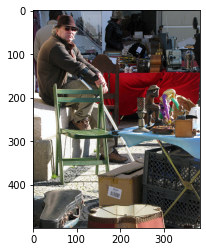

Real Caption: man sits on concrete structure in the midst of flea market
Prediction Caption: man in an orange jacket and red hat and scarf is working on the balcony
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


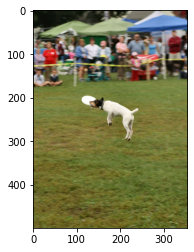

Real Caption: small brown and white dog catching frisbee at competition
Prediction Caption: dog catching frisbee in the background
BLEU-1 score: 32.206169703226536
BLEU-2 score: 28.4031719055601
BLEU-3 score: 25.863985552473196
BLEU-4 score: 3.773418367399459e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


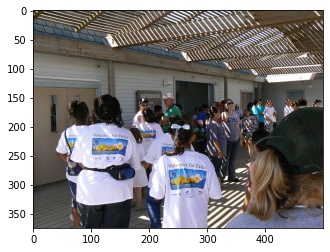

Real Caption: women waiting in line to use the ladies room
Prediction Caption: group of people in front of women
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


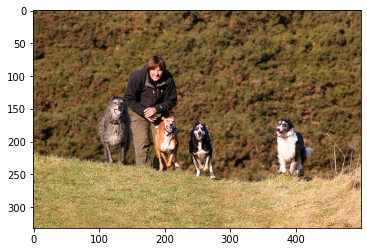

Real Caption: smiling woman watches as four dogs run on hill
Prediction Caption: three people wearing blue vest and dog run through nature
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


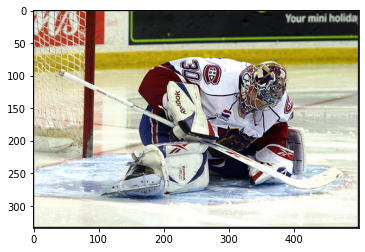

Real Caption: hockey player tries to block the puck from the goal
Prediction Caption: hockey goalie crouches in the snow
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


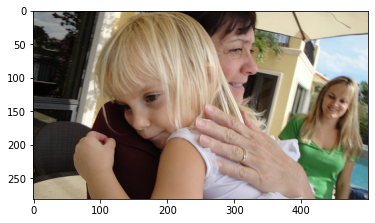

Real Caption: women maroon shirt holding child white shirt and young women green shirt in the not too far distance
Prediction Caption: woman is eating snack
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


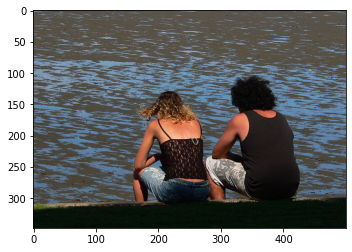

Real Caption: two people sitting out looking at the water
Prediction Caption: man and woman sitting on the beach
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


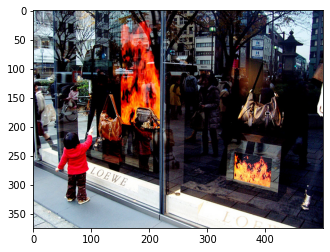

Real Caption: small child in red coat watches the fireplace display through the storefront window of purse store
Prediction Caption: woman is walking down the street
BLEU-1 score: 3.949329237565206
BLEU-2 score: 1.5586355447081413e-153
BLEU-3 score: 3.949104510872758e-184
BLEU-4 score: 3.0963867043779474e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


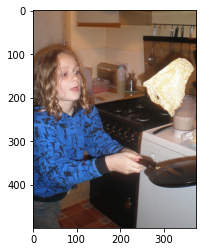

Real Caption: little girl is flipping an <unk> in the kitchen
Prediction Caption: child in blue shirt is sitting at table
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


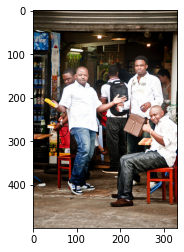

Real Caption: group of young black men smiling wearing white shirts black pants and blue jeans sitting and standing in front of store posing with their hands and thumbs up for the camera
Prediction Caption: three men in white shirts and one man and man are talking
BLEU-1 score: 11.557850616631352
BLEU-2 score: 4.911142152449472
BLEU-3 score: 4.76848591245278e-92
BLEU-4 score: 1.6542382464536984e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


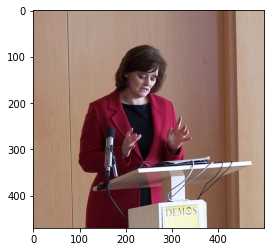

Real Caption: woman speaking at podium
Prediction Caption: woman in red vest and red shirt laughs while holding microphone giving speech
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


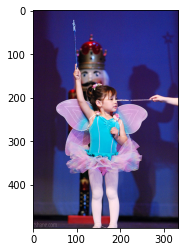

Real Caption: young girl waving <unk> leotard and pink tutu with wings waving wand
Prediction Caption: young girl wearing pink fairy costume
BLEU-1 score: 20.980356838155135
BLEU-2 score: 13.083551190106055
BLEU-3 score: 1.1224178752497289e-91
BLEU-4 score: 3.7751121892103357e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


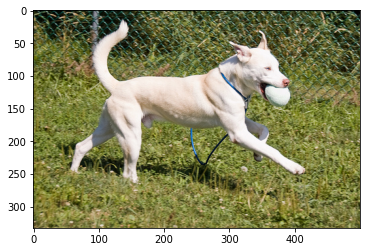

Real Caption: the dog is holding ball in his mouth
Prediction Caption: black and white dog with white dog and white dog and white dog and white dog with white dog and white dog and white dog and white dog with white dog and white dog and white dog and white dog with white dog and white dog and white dog and white dog with white dog and white dog and white dog and white dog with white dog and white dog and white dog
BLEU-1 score: 1.351351351351352
BLEU-2 score: 1.734028997897795e-153
BLEU-3 score: 7.041045372602493e-184
BLEU-4 score: 6.211555838206664e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


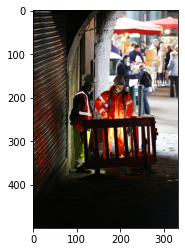

Real Caption: two construction workers are enjoying work in the shade as the city goes about its business in the background
Prediction Caption: two workmen are standing in front of building
BLEU-1 score: 10.973099593596853
BLEU-2 score: 2.835059408955042e-153
BLEU-3 score: 6.063464763332286e-184
BLEU-4 score: 4.556995351227316e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


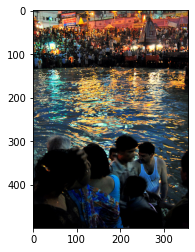

Real Caption: large crowds of people are gathered on both sides of river
Prediction Caption: people walking along the street
BLEU-1 score: 7.243303475117973
BLEU-2 score: 2.646576928737885e-153
BLEU-3 score: 6.502033690529349e-184
BLEU-4 score: 5.058927350602078e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


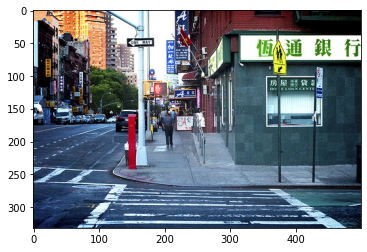

Real Caption: people are walking on the sidewalk in the city
Prediction Caption: man in black shirt and white shirt is crossing the street at an apartment building with sign that reads
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


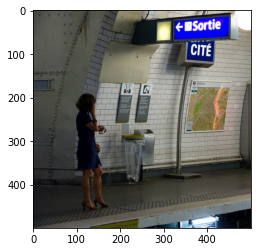

Real Caption: woman is standing on platform
Prediction Caption: woman in blue dress stands in front of an <unk>
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


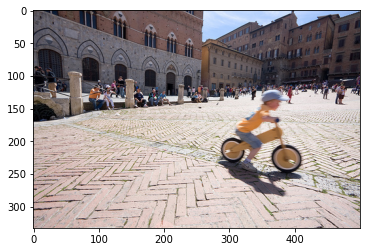

Real Caption: small boy in yellow rides bike very fast on brick road
Prediction Caption: boy in blue shirt riding yellow bike
BLEU-1 score: 34.364463939548614
BLEU-2 score: 18.368578620276967
BLEU-3 score: 1.5758123071295715e-91
BLEU-4 score: 5.300047673625059e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


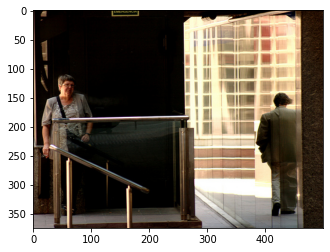

Real Caption: man walking down the street with his hands in his pocket and an elderly woman stands near staircase with her hand on her purse
Prediction Caption: woman in white shirt and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and slacks and
BLEU-1 score: 4.0540540540540535
BLEU-2 score: 3.0034263261566377e-153
BLEU-3 score: 9.789793233769279e-184
BLEU-4 score: 8.174867218666773e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


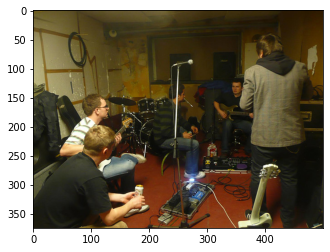

Real Caption: group of kids sat around and played their instruments
Prediction Caption: group of the members of musical instruments
BLEU-1 score: 33.09363384692233
BLEU-2 score: 20.42583425999594
BLEU-3 score: 1.8560791299878595e-91
BLEU-4 score: 6.33313451367699e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


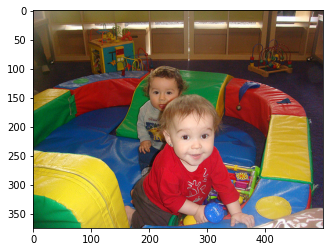

Real Caption: two young children are playing with toys
Prediction Caption: two young children are sitting in front of legos
BLEU-1 score: 40.0
BLEU-2 score: 36.51483716701108
BLEU-3 score: 36.04654325043383
BLEU-4 score: 26.26909894424158
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


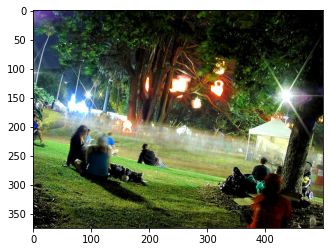

Real Caption: people are in park at night with bright lights on and watching something
Prediction Caption: people are sitting in chairs on sunny day at park
BLEU-1 score: 45.47743189500984
BLEU-2 score: 19.472272992393506
BLEU-3 score: 1.7630647642255503e-91
BLEU-4 score: 6.010342540327553e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


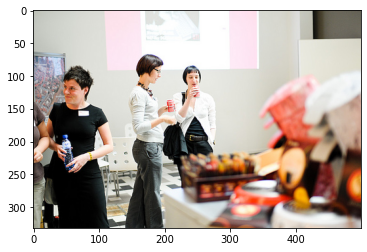

Real Caption: woman around table with <unk> items holding beverages
Prediction Caption: group of people sitting around her
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


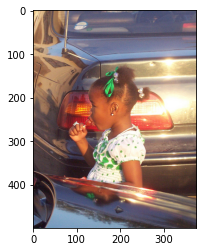

Real Caption: little girl eating <unk>
Prediction Caption: girl eating
BLEU-1 score: 47.76875403825262
BLEU-2 score: 41.36895450425725
BLEU-3 score: 2.6079672040033627e-91
BLEU-4 score: 8.121328445417259e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


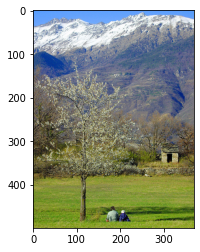

Real Caption: two people sitting in meadow enjoying mountain view
Prediction Caption: two people appear to check out of mountain
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


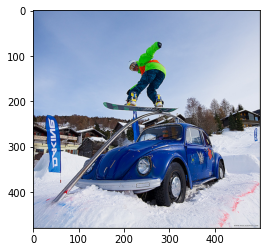

Real Caption: an athlete wearing neon green and orange snowboards over tiny blue car
Prediction Caption: man in green jacket slides down rail
BLEU-1 score: 7.581633246407919
BLEU-2 score: 3.1987476604776096e-153
BLEU-3 score: 8.324006713297918e-184
BLEU-4 score: 6.570351225189682e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


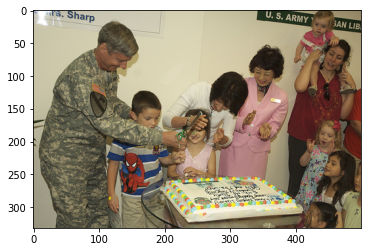

Real Caption: soldier and some civilians are cutting cake and clapping
Prediction Caption: group of women and two women are preparing food
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


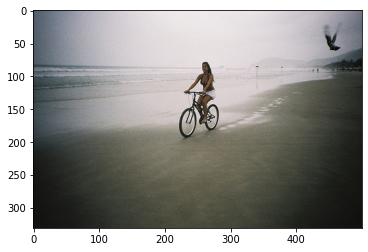

Real Caption: lady in white shorts and black tank top is riding bike along the beach
Prediction Caption: young man and woman on bike on the sand next to course
BLEU-1 score: 21.368332584053448
BLEU-2 score: 6.635198182720222e-153
BLEU-3 score: 1.5273999137122578e-183
BLEU-4 score: 1.1692181040915729e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


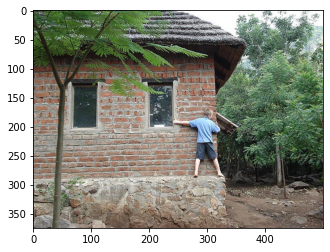

Real Caption: boy walking around the base of his house which in made of stones in his bare feet
Prediction Caption: young boy in blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue
BLEU-1 score: 2.7027027027027026
BLEU-2 score: 2.452287326375221e-153
BLEU-3 score: 8.668543674587688e-184
BLEU-4 score: 7.386826398032373e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


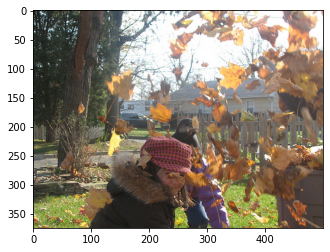

Real Caption: children tossing dead leaves on lawn
Prediction Caption: child in red dress is standing in the background
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


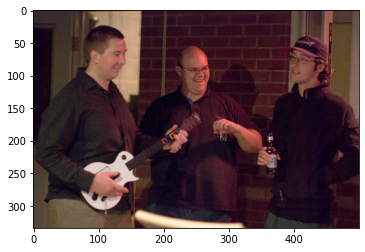

Real Caption: the three men are talking and enjoying music and beverage
Prediction Caption: three men are having conversation
BLEU-1 score: 25.6708559516296
BLEU-2 score: 22.960711579379538
BLEU-3 score: 20.9007247887124
BLEU-4 score: 2.965165608665095e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


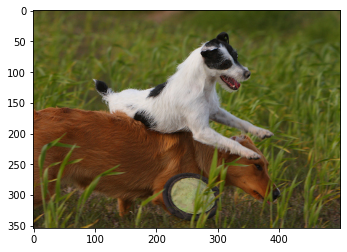

Real Caption: small dog lands on big dog trying to get disc
Prediction Caption: white and black dog is being in field of the grass
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


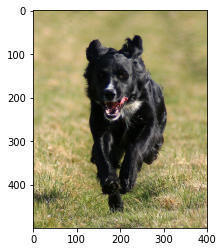

Real Caption: black <unk> runs across grassy field
Prediction Caption: black dog running in grass
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


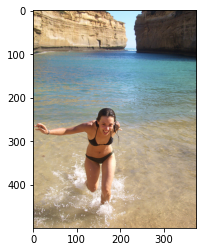

Real Caption: young girl wearing two piece black bathing suit running in the water with smile on her face
Prediction Caption: young man in white bathing suit is fishing off of the water
BLEU-1 score: 33.92960679653928
BLEU-2 score: 20.389156176875645
BLEU-3 score: 1.7234204913697732e-91
BLEU-4 score: 5.775070712302038e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


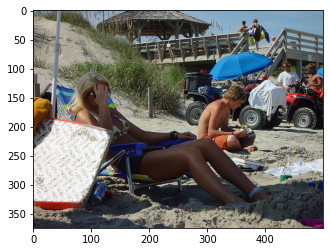

Real Caption: many people are enjoying the beach on summer day
Prediction Caption: woman sunbathing on beach
BLEU-1 score: 17.973158564688863
BLEU-2 score: 4.239031324788977e-153
BLEU-3 score: 8.741562574645582e-184
BLEU-4 score: 6.510101141652544e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


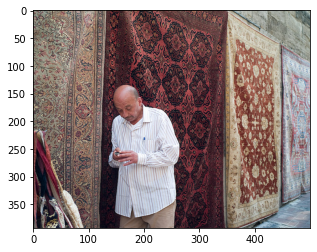

Real Caption: bald <unk> in shirt with large carpet rugs hung behind him in line
Prediction Caption: man in white shirt is standing in front of an wall
BLEU-1 score: 23.001110365733084
BLEU-2 score: 6.862004732143214e-153
BLEU-3 score: 1.5545240830508926e-183
BLEU-4 score: 1.1852285898528657e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


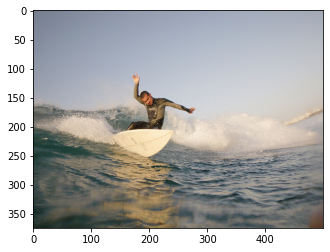

Real Caption: guy on surfboard
Prediction Caption: surfer is surfing on wave
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


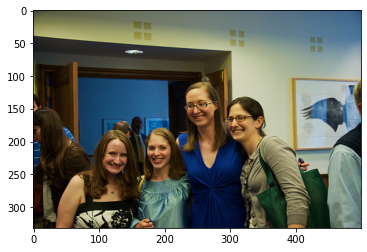

Real Caption: group of young women poses for photo
Prediction Caption: group of people gather for cold splashed by white
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


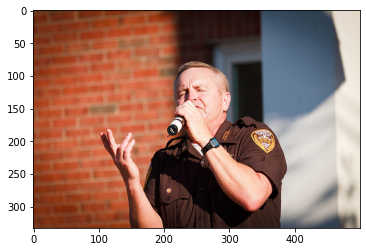

Real Caption: police office is speaking into microphone
Prediction Caption: man in brown shirt and tie sings into microphone while holding microphone towards microphone
BLEU-1 score: 13.333333333333334
BLEU-2 score: 9.75900072948533
BLEU-3 score: 1.2526984489726636e-91
BLEU-4 score: 4.65988169467104e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


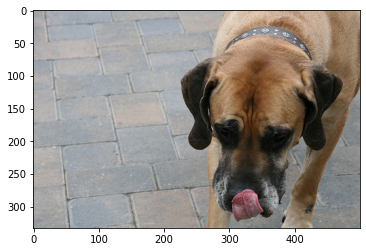

Real Caption: large dog licking its nose
Prediction Caption: dog licks his nose
BLEU-1 score: 40.0
BLEU-2 score: 9.434137710479516e-153
BLEU-3 score: 1.9454705288851736e-183
BLEU-4 score: 1.4488496539373276e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


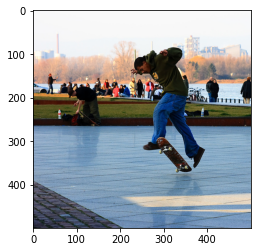

Real Caption: young man does trick on his skateboard in somewhat crowded park area
Prediction Caption: boy is doing karate moves on skate park
BLEU-1 score: 15.922918012750872
BLEU-2 score: 5.038498475779542e-153
BLEU-3 score: 1.168632815958936e-183
BLEU-4 score: 8.962731118674859e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


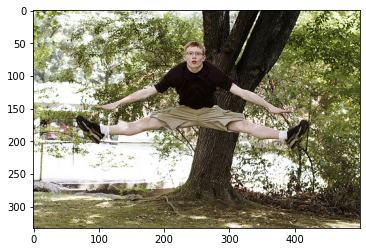

Real Caption: boy does gymnastic trick under tree
Prediction Caption: young man in blue shirt and jeans is sitting on bench in the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


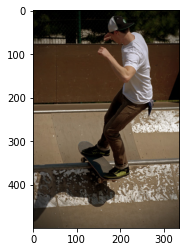

Real Caption: man does skateboard trick on snowy ground
Prediction Caption: man rides his board on his skateboard
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


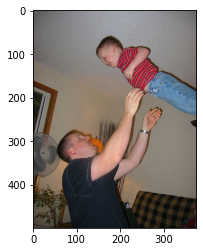

Real Caption: man tossing his son up in the air but almost having him hit the ceiling
Prediction Caption: man in gray shirt and black hair
BLEU-1 score: 10.42155049196271
BLEU-2 score: 3.1090989806586375e-153
BLEU-3 score: 7.043377891278847e-184
BLEU-4 score: 5.370140570287953e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


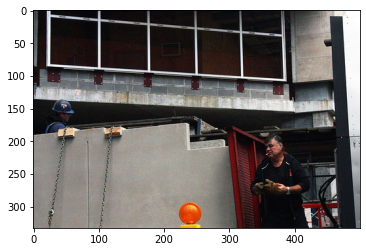

Real Caption: two men near building one smoking and pulling off leather glove and the other man is standing wearing blue construction helmet
Prediction Caption: man in black shirt is smoking cigarette in front of red and hard hats and hard hats and giving thumbs up
BLEU-1 score: 22.727272727272727
BLEU-2 score: 7.111248865046183e-153
BLEU-3 score: 1.6419913158667632e-183
BLEU-4 score: 1.2578972116573994e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


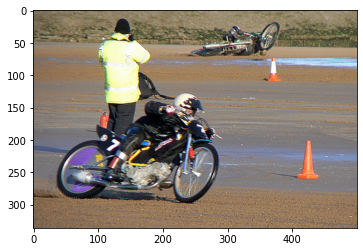

Real Caption: man on motorcycle making tight turn
Prediction Caption: two men are riding down the ground
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


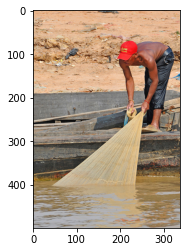

Real Caption: fisherman in red baseball cap pulling net out of murky brown water
Prediction Caption: shirtless man in red hat and life vest is fishing off to body of water
BLEU-1 score: 25.0
BLEU-2 score: 12.909944487358057
BLEU-3 score: 1.481692062358532e-91
BLEU-4 score: 5.359624986283916e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


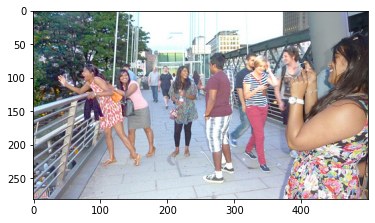

Real Caption: family of six enjoying their time out being silly
Prediction Caption: woman in pink dress is dancing at the fair
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


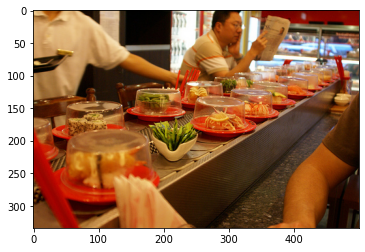

Real Caption: man is seated at counter with all types of <unk> looking foods yet is completely <unk> casually reading his newspaper
Prediction Caption: woman in red shirt and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and glasses and
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


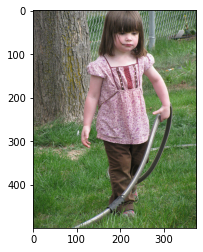

Real Caption: little girl in pink dress holding hose
Prediction Caption: young girl in the grass
BLEU-1 score: 28.2160574963538
BLEU-2 score: 21.856064155801842
BLEU-3 score: 1.9010499936561078e-91
BLEU-4 score: 6.416038883891965e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


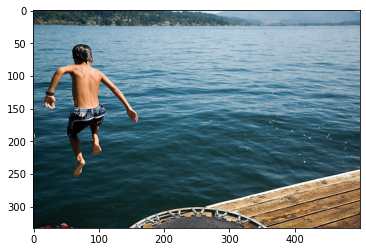

Real Caption: young boy is jumping into large body of water
Prediction Caption: boy wearing only swim trunks gets surfing on dock
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


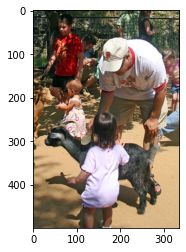

Real Caption: young child and an older man are both petting goat
Prediction Caption: woman and woman are petting dog
BLEU-1 score: 27.91881675133095
BLEU-2 score: 6.361471949532527e-153
BLEU-3 score: 1.2938603872273248e-183
BLEU-4 score: 9.602579706020655e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


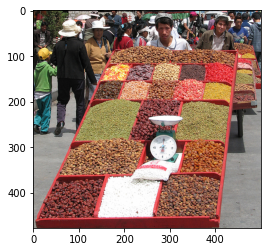

Real Caption: two men moving mobile <unk> and fruit stands through busy street
Prediction Caption: man is wheeling variety of foods down busy road
BLEU-1 score: 9.048374180359598
BLEU-2 score: 4.2681804036729734e-153
BLEU-3 score: 1.1613876691169721e-183
BLEU-4 score: 9.269981669466711e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


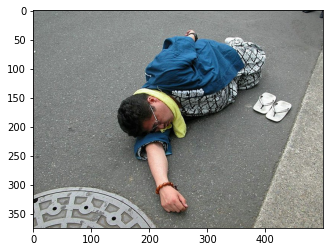

Real Caption: man passed out on the ground in the street
Prediction Caption: man lies on the pavement with his head
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


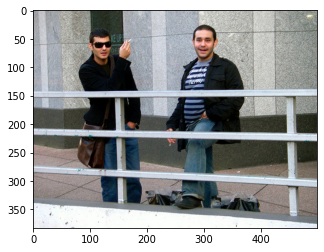

Real Caption: these men are smoking outside gray building
Prediction Caption: two men are standing at the railing
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


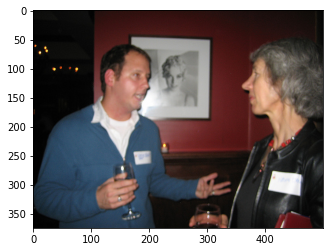

Real Caption: man talking to old woman in restaurant while holding wineglass
Prediction Caption: man and woman are sitting at table
BLEU-1 score: 19.470019576785123
BLEU-2 score: 5.808561601872144e-153
BLEU-3 score: 1.3158762272049197e-183
BLEU-4 score: 1.0032743411283238e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


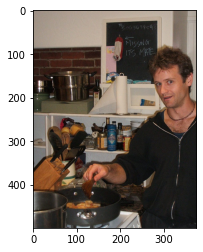

Real Caption: man cooking food on the stove
Prediction Caption: man wearing white shirt is making funny face
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


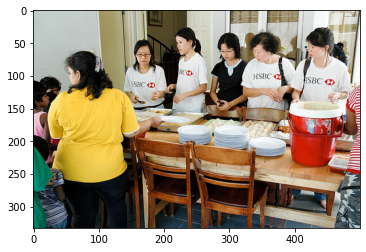

Real Caption: ladies preparing food in kitchen table
Prediction Caption: two women in red and red aprons are eating food buffet
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


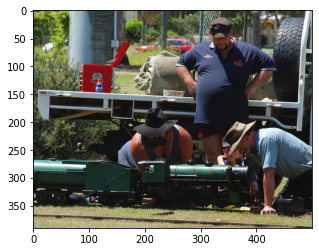

Real Caption: three men and young boy are outdoors looking at green model train
Prediction Caption: three men in green sports arena
BLEU-1 score: 20.980356838155135
BLEU-2 score: 13.083551190106055
BLEU-3 score: 1.1224178752497289e-91
BLEU-4 score: 3.7751121892103357e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


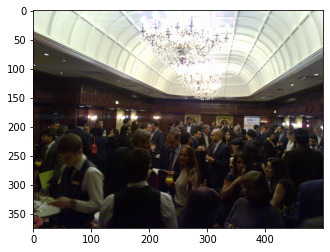

Real Caption: many people in dark cloths are drinking and talking together
Prediction Caption: people are at bar
BLEU-1 score: 14.715177646857693
BLEU-2 score: 3.470625308865635e-153
BLEU-3 score: 7.156986109817879e-184
BLEU-4 score: 5.330020010319017e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


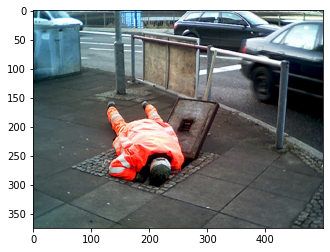

Real Caption: man dressed in orange looking down one of those holes in the street
Prediction Caption: man is sitting on the ground
BLEU-1 score: 12.124938447912854
BLEU-2 score: 3.3836527003416395e-153
BLEU-3 score: 7.463350408713334e-184
BLEU-4 score: 5.652478243478208e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


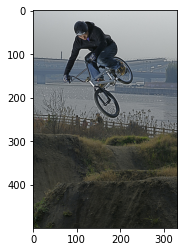

Real Caption: man is doing stunt outside on his bike
Prediction Caption: bicyclist catches some air
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


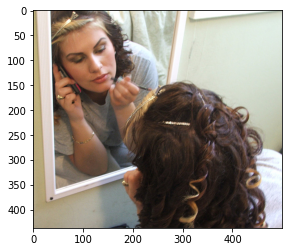

Real Caption: young woman with <unk> brown hair is putting on lipstick while listening to someone on her cellphone
Prediction Caption: woman is putting on makeup in the mirror
BLEU-1 score: 18.271657355874996
BLEU-2 score: 13.70374301690625
BLEU-3 score: 11.862010269711343
BLEU-4 score: 1.7822204843436566e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


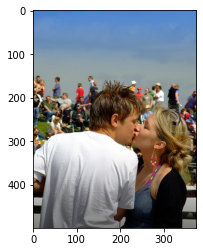

Real Caption: young couple kiss while crowd <unk> in the background on sunny day
Prediction Caption: man and woman kissing in front of crowd
BLEU-1 score: 15.922918012750872
BLEU-2 score: 5.038498475779542e-153
BLEU-3 score: 1.168632815958936e-183
BLEU-4 score: 8.962731118674859e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


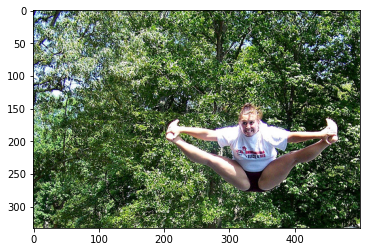

Real Caption: girl doing the splits in midair
Prediction Caption: young girl poses for or trees
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


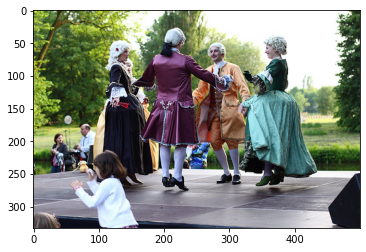

Real Caption: two men and two women dressed in old english attire hold hands and form circle on stage as young girl runs by
Prediction Caption: bride and woman dancing with two women dancing and singing
BLEU-1 score: 13.377434224416085
BLEU-2 score: 7.015185690190901
BLEU-3 score: 6.888252196571923e-92
BLEU-4 score: 2.396318608972457e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


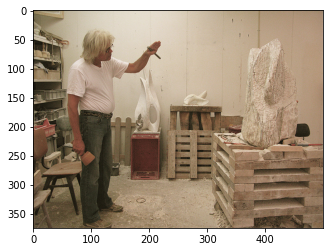

Real Caption: old man with white hair and white looking at sculpture
Prediction Caption: rock sculptor working on abstract art sculpture
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


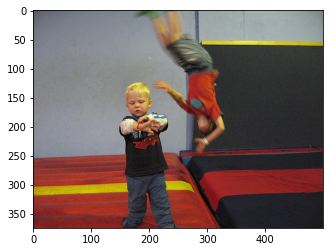

Real Caption: boy standing on red mat with person upside down in the background
Prediction Caption: boy does flip behind him
BLEU-1 score: 6.1313240195240395
BLEU-2 score: 2.2402790036937483e-153
BLEU-3 score: 5.503852693656168e-184
BLEU-4 score: 4.282289549833951e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


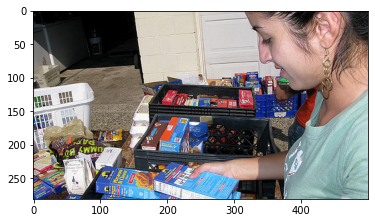

Real Caption: woman is organizing her food in milk baskets
Prediction Caption: woman in blue shirt is sorting through piles of different items on the merchandise
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


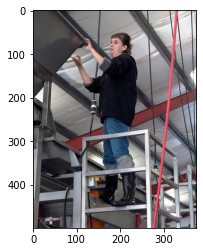

Real Caption: lady with leather boots is working on machine
Prediction Caption: man in hard hat and boots is working on building
BLEU-1 score: 36.36363636363637
BLEU-2 score: 33.02891295379082
BLEU-3 score: 32.76218166485813
BLEU-4 score: 23.462350320528
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


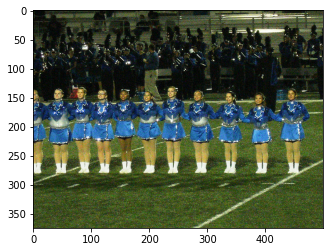

Real Caption: cheerleaders standing on football field
Prediction Caption: the cheerleaders putting on the welcome
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


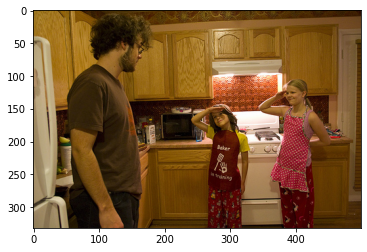

Real Caption: youth with beard and glasses is playfully <unk> by two smiling children while they all stand in kitchen
Prediction Caption: three people are in kitchen cooking
BLEU-1 score: 5.935662489817165
BLEU-2 score: 4.533437109882868
BLEU-3 score: 4.217691240873766e-92
BLEU-4 score: 1.447620200498801e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


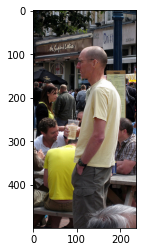

Real Caption: man with yellow shirt on stares in the distance
Prediction Caption: man in white outfit is watching something
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


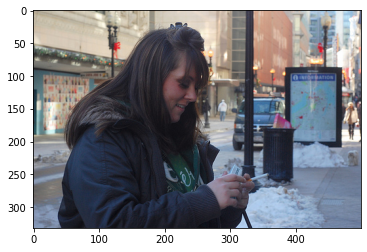

Real Caption: the woman is walking through the snow and trying to light cigarette
Prediction Caption: woman in blue jacket is sitting on the phone call outdoors on the street corner
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


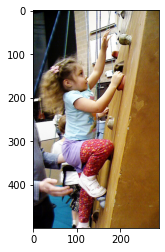

Real Caption: girl climbing on climbing ledge
Prediction Caption: little girl poses for her
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


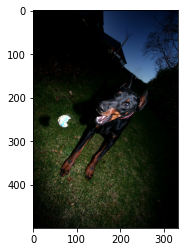

Real Caption: doberman <unk> at night
Prediction Caption: the man in the background
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


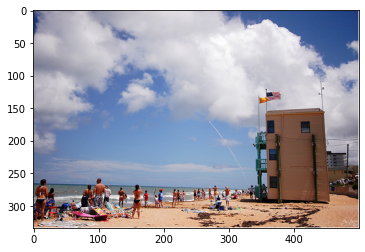

Real Caption: many people are on the beach near building with flags flying
Prediction Caption: people are playing on the beach
BLEU-1 score: 40.33700871483995
BLEU-2 score: 33.74836278166323
BLEU-3 score: 25.585464971121695
BLEU-4 score: 3.5656262927847703e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


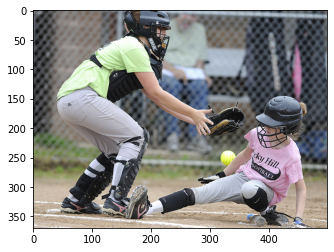

Real Caption: runner is safe at home plate at youth softball game
Prediction Caption: two soccer player makes pitch
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


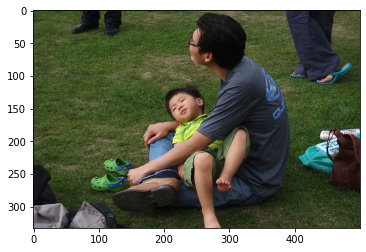

Real Caption: man in is sitting on the ground holding little boy wearing light green
Prediction Caption: man and woman in the background
BLEU-1 score: 18.18740767186928
BLEU-2 score: 4.144111291313716e-153
BLEU-3 score: 8.428711912321351e-184
BLEU-4 score: 6.255495473556936e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


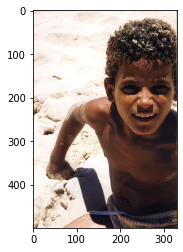

Real Caption: the boy sits in the sand with no shirt
Prediction Caption: young boy is on the head
BLEU-1 score: 21.470779802151025
BLEU-2 score: 5.991755122558557e-153
BLEU-3 score: 1.3216063232004421e-183
BLEU-4 score: 1.0009379942300741e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


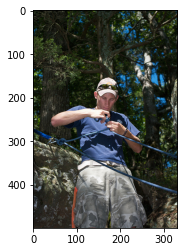

Real Caption: man in blue shirt playing with ropes in wooded area
Prediction Caption: man in blue hat ties type of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of the top of
BLEU-1 score: 4.0540540540540535
BLEU-2 score: 3.3327162207975753
BLEU-3 score: 3.601465445208982
BLEU-4 score: 7.654241337677092e-77
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


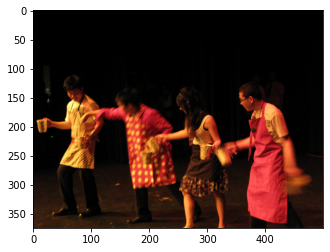

Real Caption: four people wearing aprons and holding mug in each hand are pouring something into each others <unk>
Prediction Caption: group of people are dancing for the same
BLEU-1 score: 9.135828677937498
BLEU-2 score: 2.8908557358588535e-153
BLEU-3 score: 6.705070757424583e-184
BLEU-4 score: 5.142397638489538e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


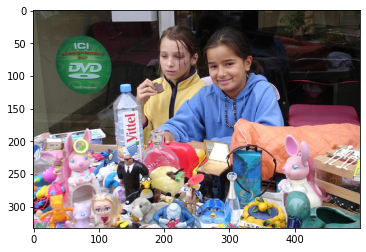

Real Caption: two young girls selling <unk>
Prediction Caption: two young girls are playing the sidewalk
BLEU-1 score: 37.5
BLEU-2 score: 32.732683535398856
BLEU-3 score: 29.891216621638705
BLEU-4 score: 4.464667296032898e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


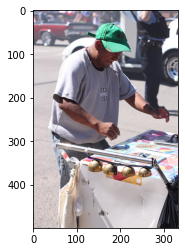

Real Caption: man making <unk> on <unk> street
Prediction Caption: man wearing blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt and blue shirt
BLEU-1 score: 1.351351351351352
BLEU-2 score: 1.734028997897795e-153
BLEU-3 score: 7.041045372602493e-184
BLEU-4 score: 6.211555838206664e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


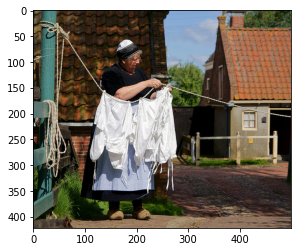

Real Caption: an elderly woman wearing an apron and black dress hangs clothes on the laundry line
Prediction Caption: woman with white dress is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes is hanging clothes
BLEU-1 score: 4.0540540540540535
BLEU-2 score: 3.0034263261566377e-153
BLEU-3 score: 9.789793233769279e-184
BLEU-4 score: 8.174867218666773e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


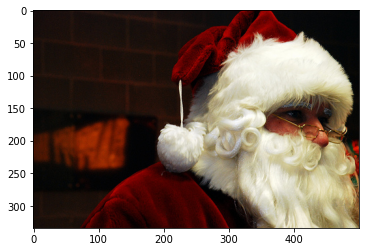

Real Caption: man is dressed as santa claus with santa suit hat beard and glasses
Prediction Caption: man playing santa clause
BLEU-1 score: 8.075860719786215
BLEU-2 score: 1.9047195540278845e-153
BLEU-3 score: 3.927837256431372e-184
BLEU-4 score: 2.925177002277079e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


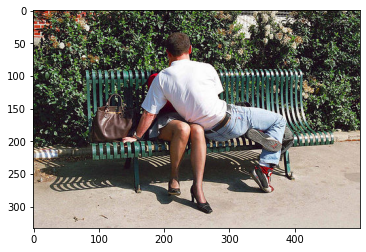

Real Caption: man sitting on top of woman on bench
Prediction Caption: man and woman are sitting on bench
BLEU-1 score: 62.5
BLEU-2 score: 42.25771273642582
BLEU-3 score: 3.0181924009135585e-91
BLEU-4 score: 9.696727898117388e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


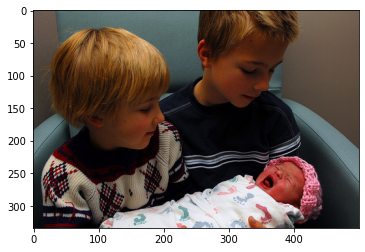

Real Caption: two teenage helping their mother to carry their small brother after their mother <unk> phone call
Prediction Caption: two children enjoying an sweaters and holding baby
BLEU-1 score: 5.104731378176962
BLEU-2 score: 2.284369557581617e-153
BLEU-3 score: 6.086243293203436e-184
BLEU-4 score: 4.832402486973384e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


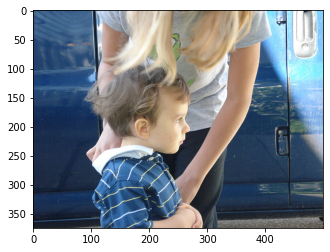

Real Caption: mother fixes her child shirt
Prediction Caption: little boy is helping young boy
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


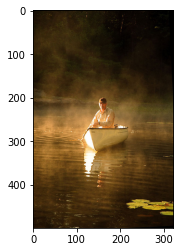

Real Caption: man in small white boat on lake
Prediction Caption: man riding dirt and the water
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


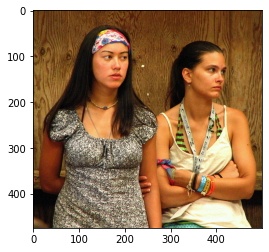

Real Caption: two young women are leaning up against wooden wall
Prediction Caption: two women wearing floral dresses
BLEU-1 score: 20.21768865708778
BLEU-2 score: 5.223533056060786e-153
BLEU-3 score: 1.117179715016979e-183
BLEU-4 score: 8.396161215621529e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


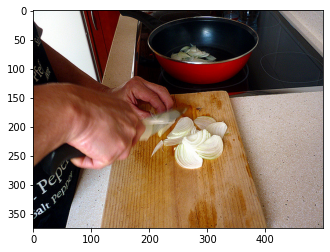

Real Caption: the cook is slicing onions in <unk> of cooking them in large red skillet
Prediction Caption: an older child are cutting board
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


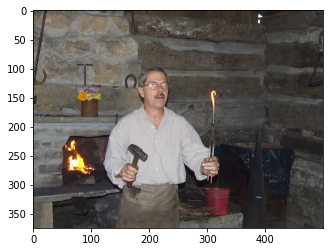

Real Caption: man in leather apron who appears to be blacksmith holds up glowing hot piece of iron which he is working on with the hammer in his right hand the <unk> fire <unk> in the background
Prediction Caption: man wearing white shirt and black hat and white shirt and white shirt and black hat and white shirt and white shirt and black hat and white shirt and white shirt and black hat and white shirt and white shirt and black hat and white shirt and white shirt and black hat and white shirt and white shirt and black hat and white shirt and white shirt and black hat and white shirt
BLEU-1 score: 1.351351351351352
BLEU-2 score: 1.734028997897795e-153
BLEU-3 score: 7.041045372602493e-184
BLEU-4 score: 6.211555838206664e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


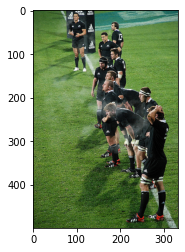

Real Caption: soccer team dressed in all black are gathered together on soccer field where it is cold <unk> to see one own breath
Prediction Caption: dozen soccer players in the background
BLEU-1 score: 3.3519761741214507
BLEU-2 score: 9.354210977457987e-154
BLEU-3 score: 2.0632659585528062e-184
BLEU-4 score: 1.5626448314168793e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


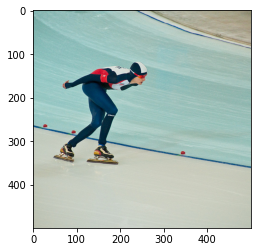

Real Caption: one person in blue leggings enjoying ice skating
Prediction Caption: olympic speed skater glides on ice
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


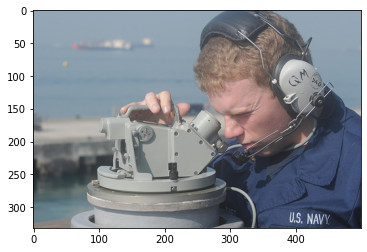

Real Caption: navy officer looks through scope
Prediction Caption: man in blue jacket is looking down
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


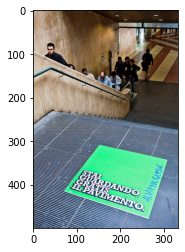

Real Caption: group of men and women walking <unk>
Prediction Caption: man is <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk> <unk>
BLEU-1 score: 2.6315789473684212
BLEU-2 score: 2.419805265385482e-153
BLEU-3 score: 8.599467903128934e-184
BLEU-4 score: 7.337741777064293e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


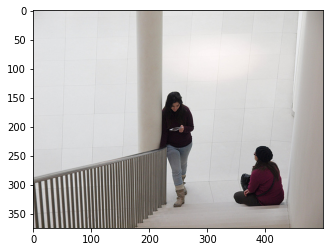

Real Caption: girl is sitting on the stairs
Prediction Caption: man sits against railing
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


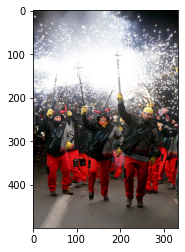

Real Caption: people dressed in red pants wearing yellow gloves hold bright fireworks suspended on long poles
Prediction Caption: group of people dressed in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume scene dressed up in red costume
BLEU-1 score: 5.405405405405406
BLEU-2 score: 4.713172478992737
BLEU-3 score: 5.458800839018001
BLEU-4 score: 3.0532787431362576
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


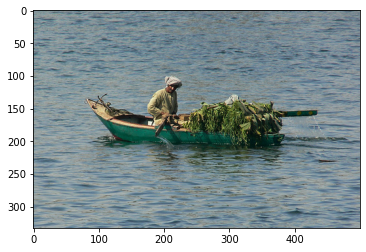

Real Caption: this old lady is rowing her crops to the city market
Prediction Caption: man in orange boat is rowing in boat
BLEU-1 score: 17.794164509262398
BLEU-2 score: 13.3456233819468
BLEU-3 score: 1.382937949398001e-91
BLEU-4 score: 4.876258334835267e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


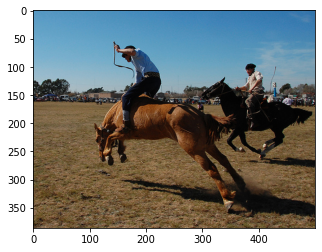

Real Caption: two men riding horses at an event
Prediction Caption: two men on horses one is riding brown horse
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


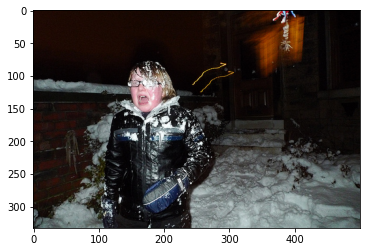

Real Caption: this boy was on the wrong end of this snowball fight
Prediction Caption: little boy with snow pants and boots is smiling little girl in snow costume
BLEU-1 score: 6.666666666666667
BLEU-2 score: 3.851470592303926e-153
BLEU-3 score: 1.1365257532669032e-183
BLEU-4 score: 9.25732495472854e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


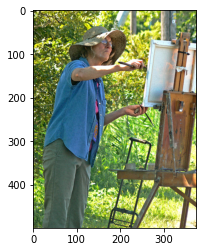

Real Caption: woman in blue shirt and big hat paints outside with trees in the background
Prediction Caption: determined to capture the of his head
BLEU-1 score: 5.904581909262685
BLEU-2 score: 2.4911871828277866e-153
BLEU-3 score: 6.48274294660805e-184
BLEU-4 score: 5.116994679231889e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


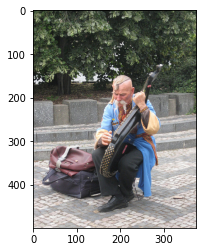

Real Caption: man sitting in park is playing musical instrument
Prediction Caption: man in blue shirt is playing the steps
BLEU-1 score: 44.44444444444444
BLEU-2 score: 23.570226039551585
BLEU-3 score: 2.1262855015914923e-91
BLEU-4 score: 7.241926111174567e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


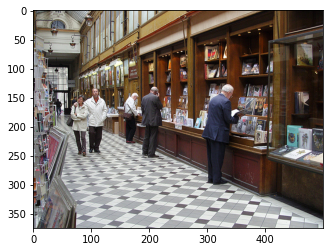

Real Caption: couple walks down an <unk> at store selling art and <unk> books
Prediction Caption: people are shopping in store
BLEU-1 score: 6.1313240195240395
BLEU-2 score: 2.2402790036937483e-153
BLEU-3 score: 5.503852693656168e-184
BLEU-4 score: 4.282289549833951e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


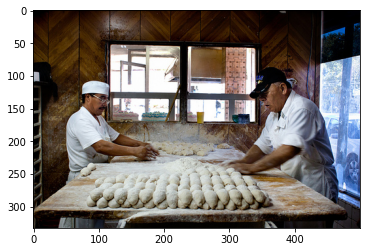

Real Caption: two older men wearing white <unk> bread on flour covered table
Prediction Caption: two men in bakery one is doing dirty and white prepare professionals to be cooked
BLEU-1 score: 18.75
BLEU-2 score: 6.459112543299825e-153
BLEU-3 score: 1.549911998981145e-183
BLEU-4 score: 1.198832868637291e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


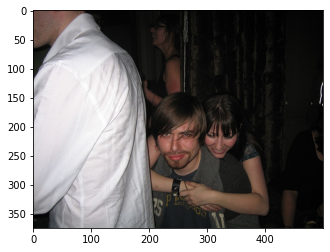

Real Caption: male that has <unk> haired lady on his back
Prediction Caption: man and woman sitting on the cheek
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


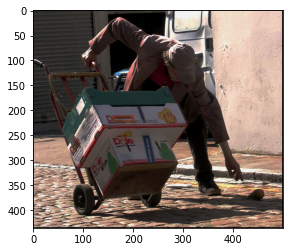

Real Caption: man is bent over trying to pick up the <unk>
Prediction Caption: man transporting produce reaches for
BLEU-1 score: 8.556951983876534
BLEU-2 score: 3.126561213214481e-153
BLEU-3 score: 7.68124520511009e-184
BLEU-4 score: 5.9764165035645785e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


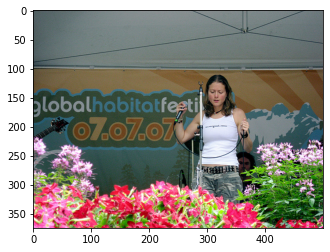

Real Caption: young lady is getting ready to sing into microphone
Prediction Caption: woman in white dress is sitting in front of displays heavily displays heavily displays heavily show
BLEU-1 score: 5.88235294117647
BLEU-2 score: 3.6178266619513135e-153
BLEU-3 score: 1.0946416849080909e-183
BLEU-4 score: 8.972141065609098e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


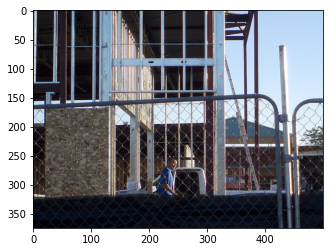

Real Caption: the view of man with shaved head and blue shirt through fence
Prediction Caption: man in white shirt is walking past brick building
BLEU-1 score: 16.374615061559638
BLEU-2 score: 5.461705981224581e-153
BLEU-3 score: 1.2937690606722724e-183
BLEU-4 score: 9.97486269044271e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


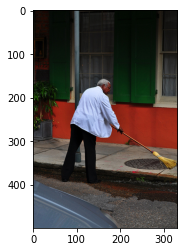

Real Caption: an older man sweeping the street
Prediction Caption: man in blue shirt and jeans is sweeping the bench
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


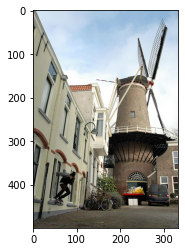

Real Caption: person skateboarding near <unk>
Prediction Caption: man is standing on the balcony
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
BLEU-1 count: 160
BLEU-2 count: 64
BLEU-3 count: 23
BLEU-4 count: 6
BLEU-1 Total: 40.432731791756424
BLEU-2 Total: 16.32461824765272
BLEU-3 Total: 6.870860105239934
BLEU-4 Total: 1.6509844680065004
BLEU-1 Average: 0.25270457369847765
BLEU-2 Average: 0.25507216011957373
BLEU-3 Average: 0.29873304805391016
BLEU-4 Average: 0.2751640780010834
Real Caption: person skateboarding near <unk>
Prediction Caption: man is standing on the balcony
Blue score count > 0.1 160
Blue score average >0.1 0.25270457369847765


In [125]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(250):    
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]

    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    image = img_name_val[rid]
    split_image  = image.split("/")
    image = PATH1+split_image[3]
    result, attention_plot = evaluate(image)

    # remove <start> and <end> from the real_caption
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    #Image.open(img_name_val[rid])
    #remove "<unk>" in result
    for i in result:
        if i=="<unk>":
            result.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result        
    result_join = ' '.join(result)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = result
    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', result_final)
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")

    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', result_final)

    #plot_attention(image, result, attention_plot)
if blue_count_1 > 0:
    print("Blue score count > 0.1",blue_count_1)
    print("Blue score average >0.1",blue_1/blue_count_1)

In [ ]:
#-------------------END------------------------